# Importing libraries and loading dataset

In [1]:
# Importing the libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import scipy.stats as stats
from scipy.stats.mstats import winsorize
from pandas.plotting import lag_plot
from sklearn.preprocessing import PowerTransformer, QuantileTransformer, StandardScaler, MinMaxScaler

In [2]:
# Loading the dataset

df = pd.read_csv("Data Set/Wind_turbine.csv")
df

,date,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature,Failure_status
0,2/1/2021,7.878531,2.315370,32.740165,86.452399,65.049688,33.680184,134.147513,56.460579,100.000000,1456.017383,14.437189,7.276999,12.738843,17.584294,No_failure
1,4/29/2021,43.880415,0.780599,-55.994974,59.779321,101.430997,-17.601422,24.198260,-4.882679,39.030739,361.979447,98.159201,148.106847,-75.941163,28.078778,Failure
2,7/27/2021,14.215257,2.089855,40.000000,81.044978,50.000000,28.690093,134.453792,43.267269,93.971237,1402.969527,14.889174,209.730805,62.908711,13.796216,No_failure
3,6/5/2021,41.578706,0.149758,-54.050003,46.767316,112.224552,-2.777622,23.758713,7.769757,15.757189,520.033943,165.953430,218.713930,-74.258910,21.982525,Failure
4,5/26/2021,19.067139,2.973043,12.731400,89.489402,84.527008,40.000000,111.173738,48.206219,70.000000,1167.887109,13.514680,32.583664,7.287559,11.303292,No_failure
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,9/29/2021,0.031313,5.435003,53.310500,132.768991,111.028171,81.099550,358.913420,93.016807,145.492569,2439.353445,150.049320,375.717398,110.750778,118.065963,Failure
3596,3/10/2021,3.231213,2.598571,4.208532,74.090434,57.955346,22.602701,52.221794,47.037018,70.000000,1292.399953,9.812319,35.541569,6.268785,15.082957,No_failure
3597,11/2/2021,3.005981,3.020017,6.834426,83.197439,61.598519,38.776535,121.583425,31.492799,80.490588,1210.191300,1.306543,25.583091,42.951647,10.000000,No_failure
3598,6/11/2021,19.858333,2.608177,2.710879,77.173335,74.066225,6.828494,214.499735,45.924037,100.000000,1563.565899,2.552398,12.700684,38.294409,12.619178,No_failure


# Descriptive Statistics

In [3]:
df.shape

(3600, 16)

In [4]:
df.describe()

,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature
count,3580.000000,3575.000000,3594.000000,3600.000000,3600.000000,3600.000000,3600.000000,3594.000000,3600.000000,3582.000000,3574.000000,3600.000000,3600.000000,3597.000000
mean,16.649779,3.366524,11.553371,84.910653,85.104356,17.258018,187.725740,45.181158,81.406848,1416.165751,49.990327,61.672044,20.114653,30.121688
std,13.316537,2.629256,43.946111,28.574645,23.237532,29.051354,122.926804,25.800055,30.660571,548.057852,56.374927,110.238694,57.782232,30.210642
min,-5.282205,0.001426,-263.018697,10.018170,50.000000,-20.000000,0.048201,-19.928440,10.020087,301.024856,0.014799,-416.325090,-89.889157,10.000000
25%,6.636192,2.247888,1.152290,73.325282,66.617971,-3.801116,95.775827,35.224818,70.000000,1143.711916,6.583051,10.701335,-19.526400,14.107718
50%,14.103255,2.731590,9.893326,83.938139,77.723856,9.955559,178.855084,45.312836,70.000000,1405.424602,18.363724,37.570098,20.421133,16.963881
75%,22.009360,3.274195,28.299636,95.912783,107.423215,29.618671,255.221624,55.788863,100.000000,1683.023815,94.487398,92.520724,60.715205,24.985291
max,54.422349,11.992076,293.004752,144.995476,129.984431,84.991308,449.616100,118.076163,149.949119,4003.655521,179.959470,636.424261,119.932205,119.965417


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3600 entries, 0 to 3599
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   date                           3600 non-null   object 
 1   Wind_speed                     3580 non-null   float64
 2   Power                          3575 non-null   float64
 3   Nacelle_ambient_temperature    3594 non-null   float64
 4   Generator_bearing_temperature  3600 non-null   float64
 5   Gear_oil_temperature           3600 non-null   float64
 6   Ambient_temperature            3600 non-null   float64
 7   Rotor_Speed                    3600 non-null   float64
 8   Nacelle_temperature            3594 non-null   float64
 9   Bearing_temperature            3600 non-null   float64
 10  Generator_speed                3582 non-null   float64
 11  Yaw_angle                      3574 non-null   float64
 12  Wind_direction                 3600 non-null   f

In [6]:
for column in df.select_dtypes(include="number").columns:
    print(f'{column} values from {df[column].min()} to {df[column].max()}')

Wind_speed values from -5.282204848 to 54.42234925
Power values from 0.001426011 to 11.99207606
Nacelle_ambient_temperature values from -263.0186975 to 293.004752
Generator_bearing_temperature values from 10.01817035 to 144.9954761
Gear_oil_temperature values from 50.0 to 129.984431
Ambient_temperature values from -20.0 to 84.99130777
Rotor_Speed values from 0.048200891 to 449.6161004
Nacelle_temperature values from -19.92844 to 118.0761628
Bearing_temperature values from 10.02008702 to 149.9491192
Generator_speed values from 301.0248557 to 4003.655521
Yaw_angle values from 0.014799159 to 179.9594703
Wind_direction values from -416.3250899 to 636.4242615
Wheel_hub_temperature values from -89.88915734 to 119.9322055
Gear_box_inlet_temperature values from 10.0 to 119.9654173


In [7]:
df['Failure_status'].unique()

array(['No_failure', 'Failure'], dtype=object)

# Business decision

## First moment business decision (Measures of Central Tendency)

In [8]:
for column in df.select_dtypes(include="number").columns:
    print(f'Mean of {column}: {df[column].mean()}')
    print(f'Median of {column}: {df[column].median()}')
    print(f'Mode of {column}: {df[column].mode()}')

Mean of Wind_speed: 16.649779204185755
Median of Wind_speed: 14.10325452
Mode of Wind_speed: 0    25.0
Name: Wind_speed, dtype: float64
Mean of Power: 3.3665242574198606
Median of Power: 2.731589543
Mode of Power: 0    2.0
Name: Power, dtype: float64
Mean of Nacelle_ambient_temperature: 11.553371045812186
Median of Nacelle_ambient_temperature: 9.893326186500001
Mode of Nacelle_ambient_temperature: 0    40.0
Name: Nacelle_ambient_temperature, dtype: float64
Mean of Generator_bearing_temperature: 84.9106533969139
Median of Generator_bearing_temperature: 83.93813871
Mode of Generator_bearing_temperature: 0        10.018170
1        10.025795
2        10.210716
3        10.382185
4        10.432457
           ...    
3595    144.699011
3596    144.846802
3597    144.866362
3598    144.951829
3599    144.995476
Name: Generator_bearing_temperature, Length: 3600, dtype: float64
Mean of Gear_oil_temperature: 85.10435576707499
Median of Gear_oil_temperature: 77.723856485
Mode of Gear_oil_temper

## Second moment business decision (Measures of Dispersion)

In [9]:
for column in df.select_dtypes(include="number").columns:
    print(f'Variance of {column}: {df[column].var()}')
    print(f'Standard Deviation of {column}: {df[column].std()}')
    print(f'Range of {column}: {df[column].max() - df[column].min()}')

Variance of Wind_speed: 177.3301692978831
Standard Deviation of Wind_speed: 13.31653743650665
Range of Wind_speed: 59.704554098
Variance of Power: 6.912988166029802
Standard Deviation of Power: 2.6292562001504916
Range of Power: 11.990650049000001
Variance of Nacelle_ambient_temperature: 1931.260705440572
Standard Deviation of Nacelle_ambient_temperature: 43.94611138019577
Range of Nacelle_ambient_temperature: 556.0234495
Variance of Generator_bearing_temperature: 816.510348282403
Standard Deviation of Generator_bearing_temperature: 28.574645199589146
Range of Generator_bearing_temperature: 134.97730575
Variance of Gear_oil_temperature: 539.9829131708453
Standard Deviation of Gear_oil_temperature: 23.237532424309716
Range of Gear_oil_temperature: 79.984431
Variance of Ambient_temperature: 843.9811687358592
Standard Deviation of Ambient_temperature: 29.05135399143832
Range of Ambient_temperature: 104.99130777
Variance of Rotor_Speed: 15110.999161338916
Standard Deviation of Rotor_Speed:

## Third moment business decision (Measures of Skewness)

In [10]:
for column in df.select_dtypes(include="number").columns:
    print(f'Skewness of {column}: {df[column].skew()}')

Skewness of Wind_speed: 0.8053633885744104
Skewness of Power: 1.6127413824586472
Skewness of Nacelle_ambient_temperature: 0.9296899732534663
Skewness of Generator_bearing_temperature: -0.12751769834474075
Skewness of Gear_oil_temperature: 0.4319287496228611
Skewness of Ambient_temperature: 0.8991094237411186
Skewness of Rotor_Speed: 0.3791561919650701
Skewness of Nacelle_temperature: -0.17197029841285527
Skewness of Bearing_temperature: 0.07746160840407385
Skewness of Generator_speed: 0.14288674228300224
Skewness of Yaw_angle: 0.962511061970742
Skewness of Wind_direction: 0.9426563119004392
Skewness of Wheel_hub_temperature: -0.05750111483404396
Skewness of Gear_box_inlet_temperature: 1.856304780801009


## Fourth moment business decision (Measures of Kurtosis)

In [11]:
for column in df.select_dtypes(include="number").columns:
    print(f'Kurtosis of {column}: {df[column].kurt()}')

Kurtosis of Wind_speed: -0.37103165638785773
Kurtosis of Power: 2.1085541206499236
Kurtosis of Nacelle_ambient_temperature: 4.678433075186085
Kurtosis of Generator_bearing_temperature: 0.3942116919738914
Kurtosis of Gear_oil_temperature: -1.1371245847319922
Kurtosis of Ambient_temperature: -0.21694768803356723
Kurtosis of Rotor_Speed: -0.7048684287479836
Kurtosis of Nacelle_temperature: 0.26794689644540703
Kurtosis of Bearing_temperature: -0.1218435107320559
Kurtosis of Generator_speed: -0.03798068676504185
Kurtosis of Yaw_angle: -0.5832837047482728
Kurtosis of Wind_direction: 3.9723042505471726
Kurtosis of Wheel_hub_temperature: -0.8832895246685268
Kurtosis of Gear_box_inlet_temperature: 1.8336296539475923


# Missing values

## Checking for missing values

In [12]:
df.isnull().sum()

date                              0
Wind_speed                       20
Power                            25
Nacelle_ambient_temperature       6
Generator_bearing_temperature     0
Gear_oil_temperature              0
Ambient_temperature               0
Rotor_Speed                       0
Nacelle_temperature               6
Bearing_temperature               0
Generator_speed                  18
Yaw_angle                        26
Wind_direction                    0
Wheel_hub_temperature             0
Gear_box_inlet_temperature        3
Failure_status                    0
dtype: int64

## Handle missing values

In [13]:
from sklearn.impute import SimpleImputer

# For numerical columns
num_cols = df.select_dtypes(include='number').columns
imputer = SimpleImputer(strategy='mean')  # or 'median', 'most_frequent'
df[num_cols] = imputer.fit_transform(df[num_cols])

In [14]:
# # Winsorization
# from scipy.stats.mstats import winsorize

# for column in df.select_dtypes(include="number").columns:
#     df[column] = winsorize(df[column], limits=[0.05,0.05])


In [15]:
df.isnull().sum()

date                             0
Wind_speed                       0
Power                            0
Nacelle_ambient_temperature      0
Generator_bearing_temperature    0
Gear_oil_temperature             0
Ambient_temperature              0
Rotor_Speed                      0
Nacelle_temperature              0
Bearing_temperature              0
Generator_speed                  0
Yaw_angle                        0
Wind_direction                   0
Wheel_hub_temperature            0
Gear_box_inlet_temperature       0
Failure_status                   0
dtype: int64

## Handling duplicate values

In [16]:
print(df.duplicated().sum())

0


# Univariate Analysis

# Outlier Detection

## Checking for outliers using boxplot

Boxplot for Wind_speed


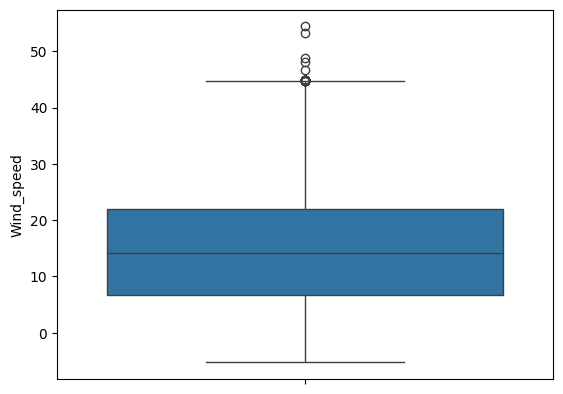

Boxplot for Power


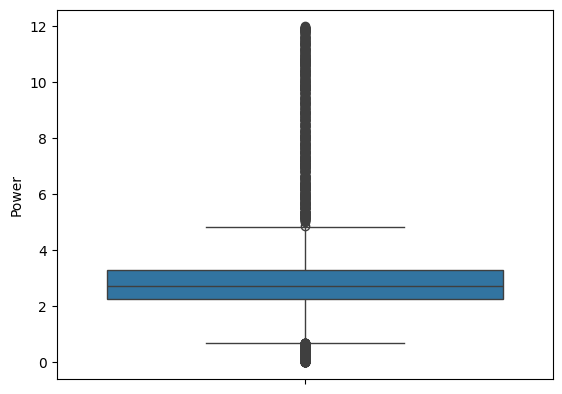

Boxplot for Nacelle_ambient_temperature


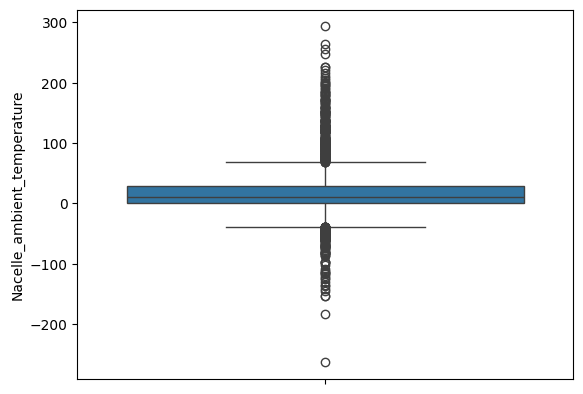

Boxplot for Generator_bearing_temperature


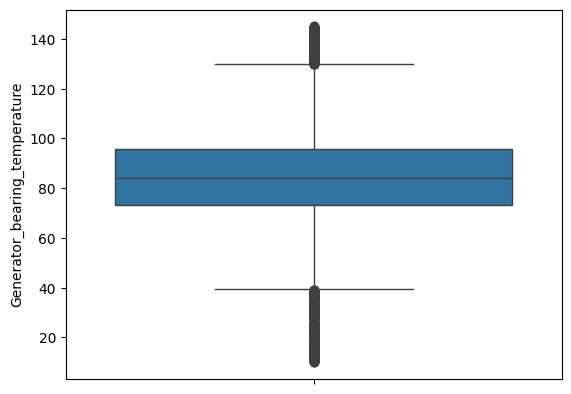

Boxplot for Gear_oil_temperature


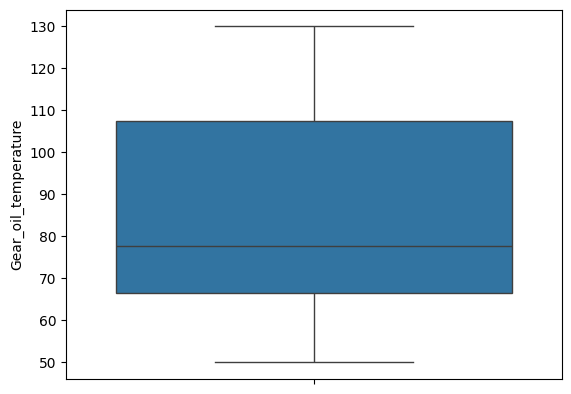

Boxplot for Ambient_temperature


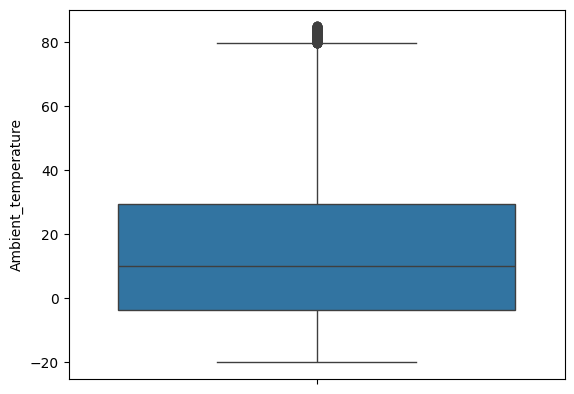

Boxplot for Rotor_Speed


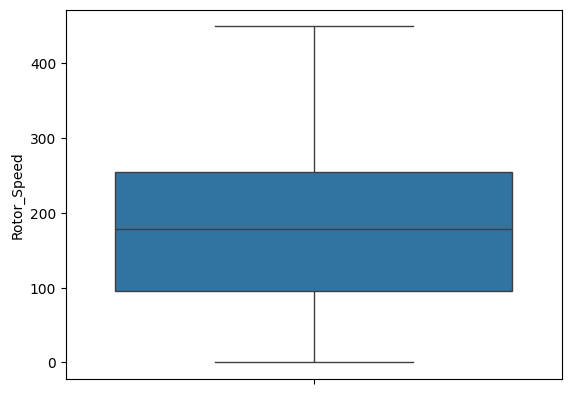

Boxplot for Nacelle_temperature


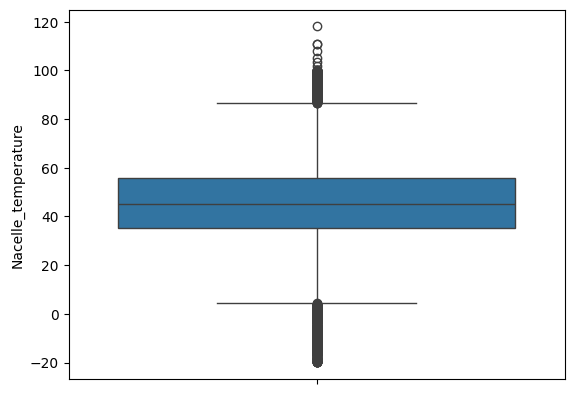

Boxplot for Bearing_temperature


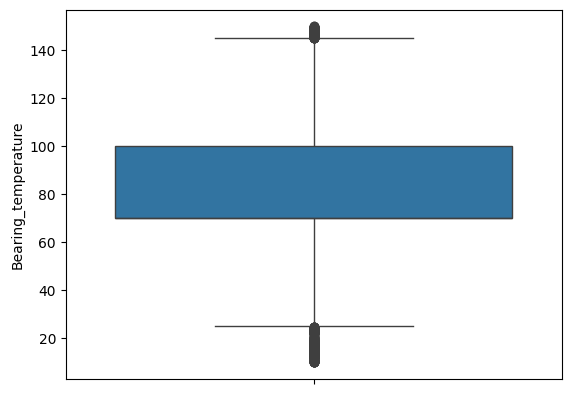

Boxplot for Generator_speed


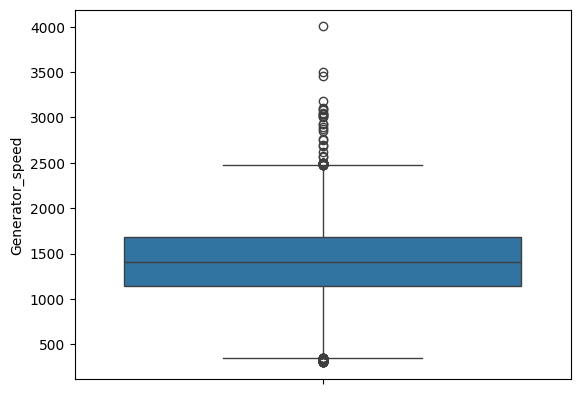

Boxplot for Yaw_angle


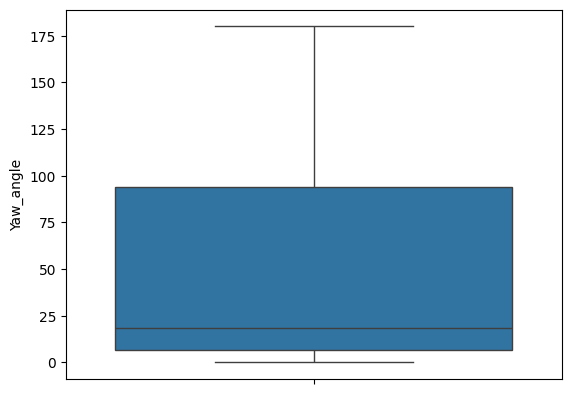

Boxplot for Wind_direction


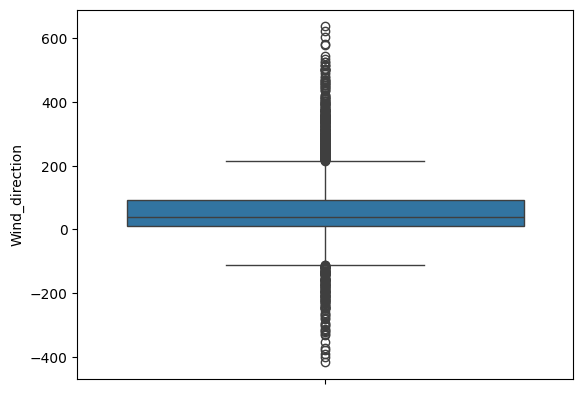

Boxplot for Wheel_hub_temperature


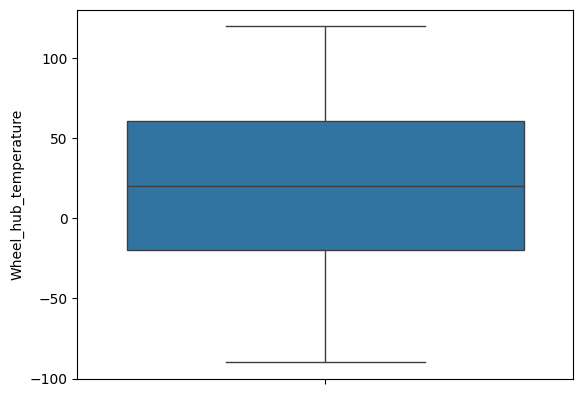

Boxplot for Gear_box_inlet_temperature


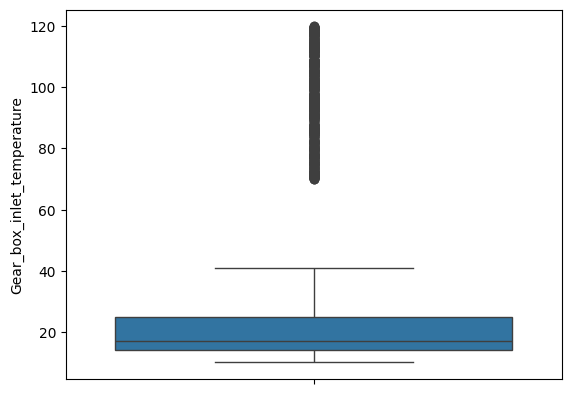

In [17]:
for column in df.select_dtypes(include="number").columns:
    sns.boxplot(data=df[column])
    print(f'Boxplot for {column}')
    plt.show()

In [18]:
df['Wind_speed'].isnull().sum()

np.int64(0)

In [19]:
df['Failure_status'].unique()

array(['No_failure', 'Failure'], dtype=object)

# Checking for normal distribution using histogram

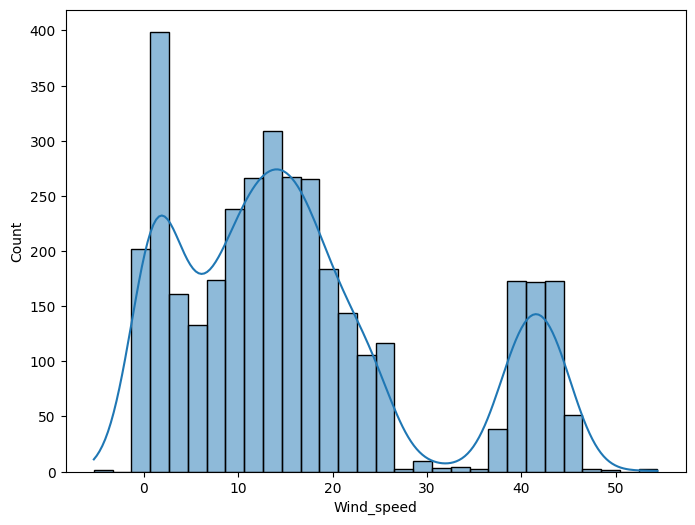

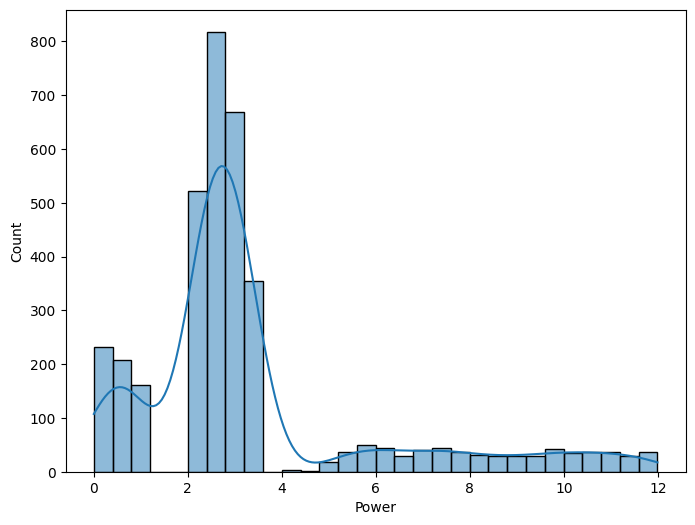

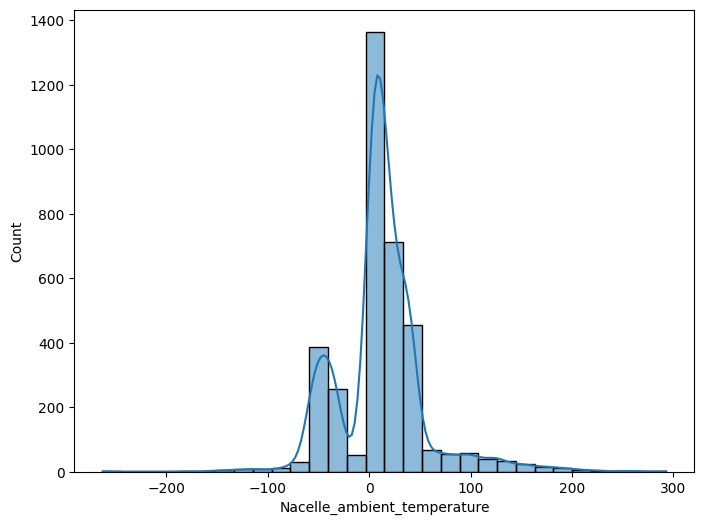

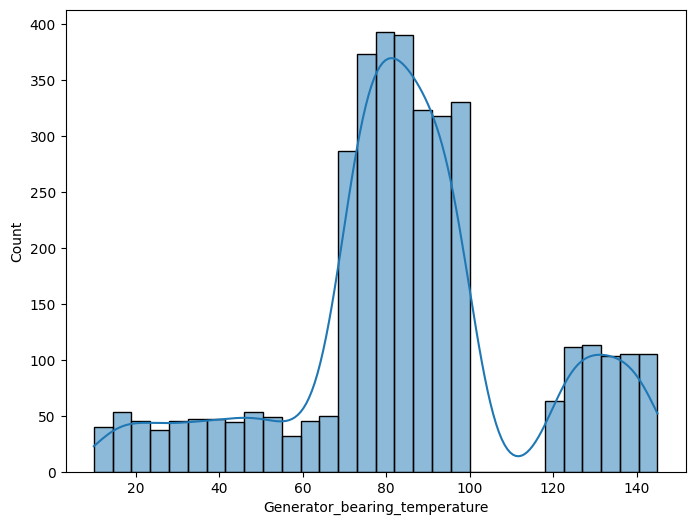

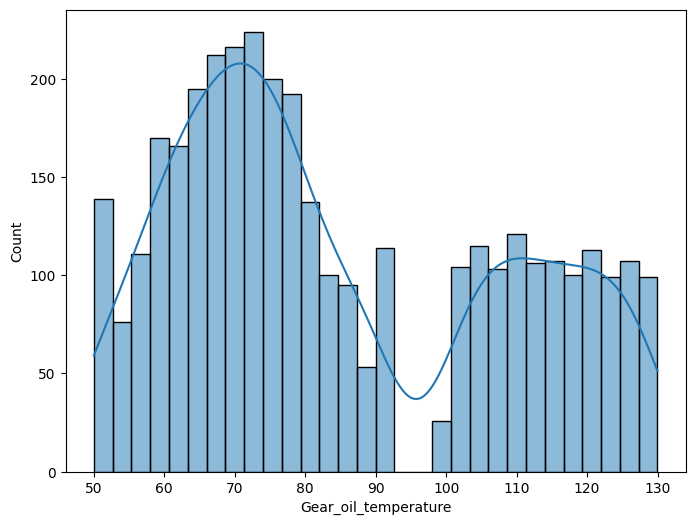

...

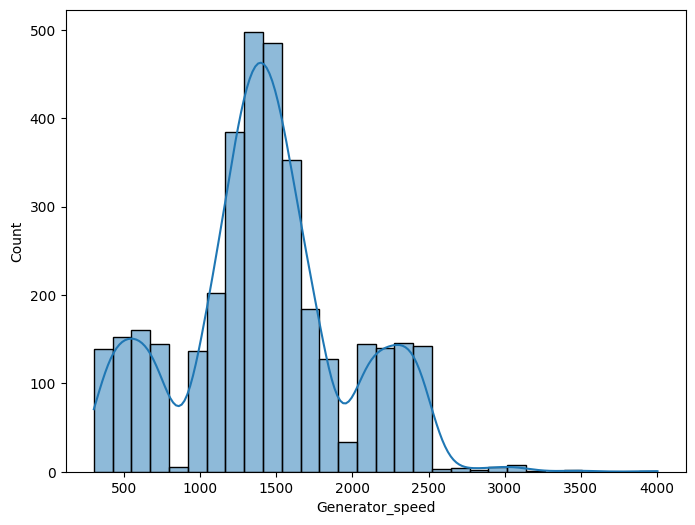

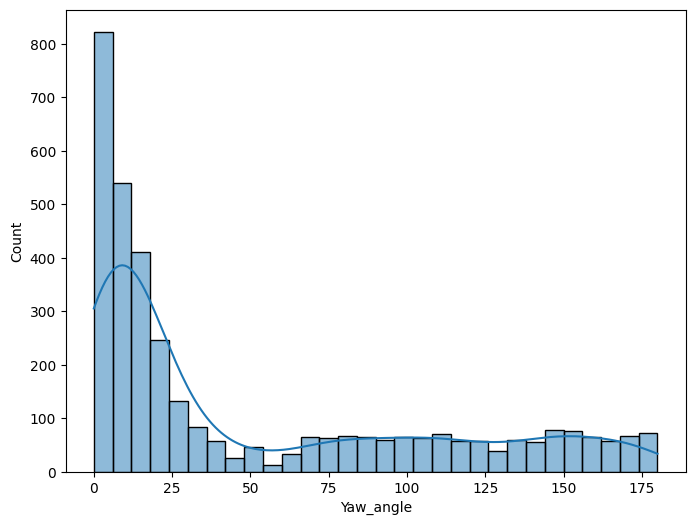

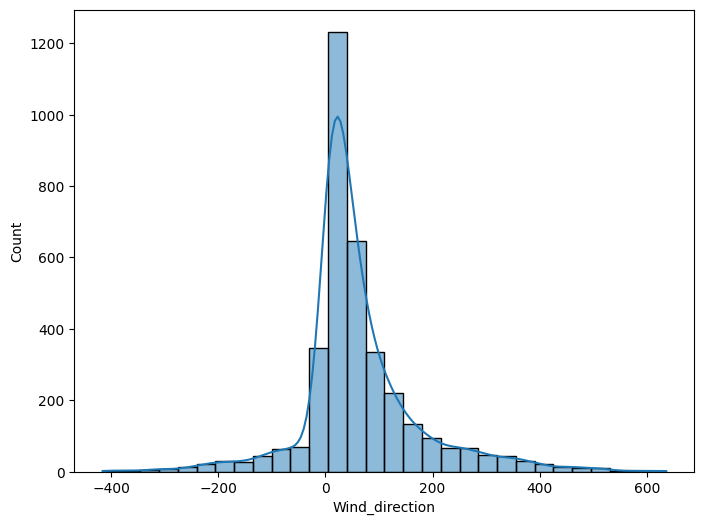

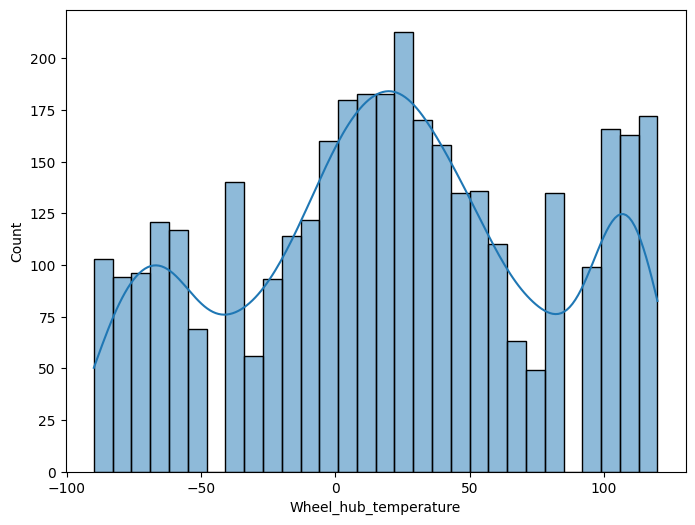

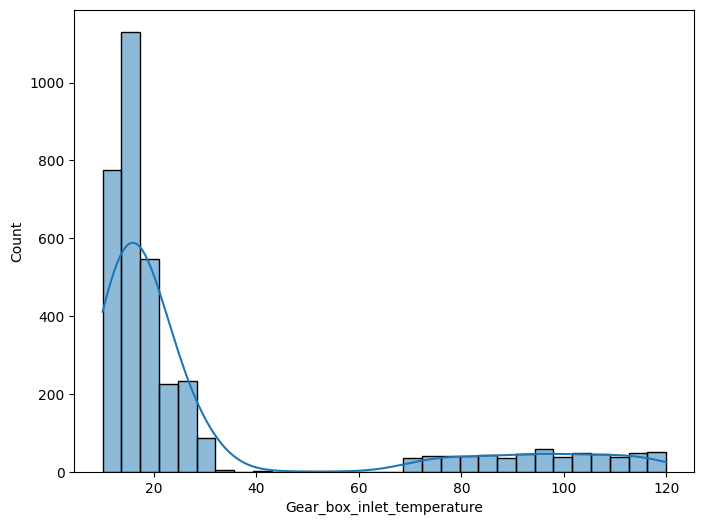

In [20]:
for column in df.select_dtypes(include="number").columns:
    plt.figure(figsize=(8,6))
    sns.histplot(df[column], bins=30, kde=True)

In [21]:
df.columns

Index(['date', 'Wind_speed', 'Power', 'Nacelle_ambient_temperature',
       'Generator_bearing_temperature', 'Gear_oil_temperature',
       'Ambient_temperature', 'Rotor_Speed', 'Nacelle_temperature',
       'Bearing_temperature', 'Generator_speed', 'Yaw_angle', 'Wind_direction',
       'Wheel_hub_temperature', 'Gear_box_inlet_temperature',
       'Failure_status'],
      dtype='object')

## Time Plot

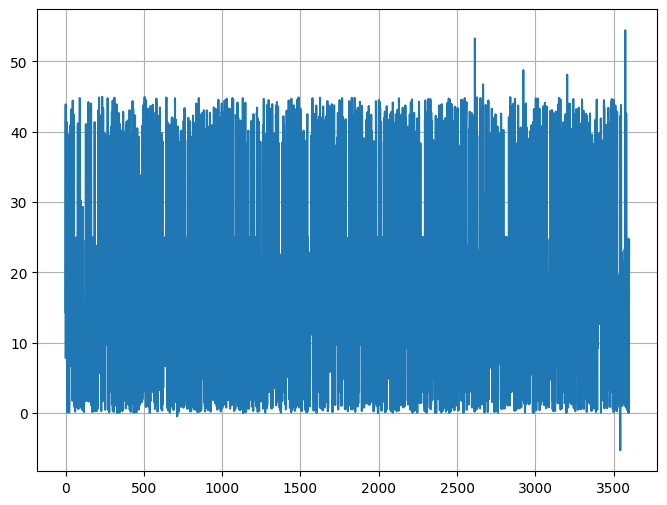

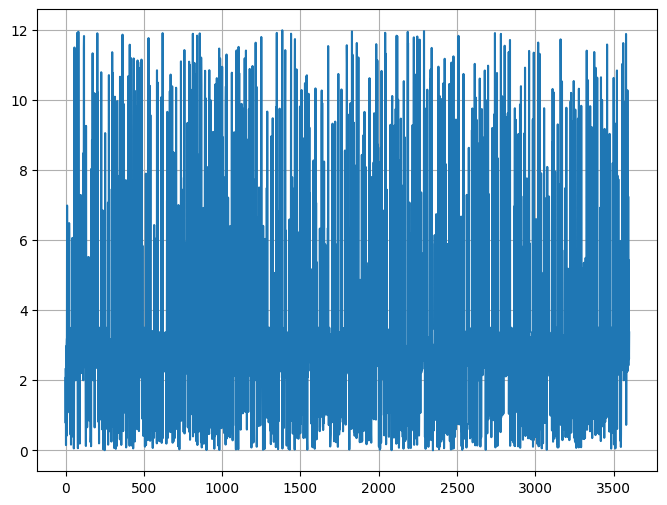

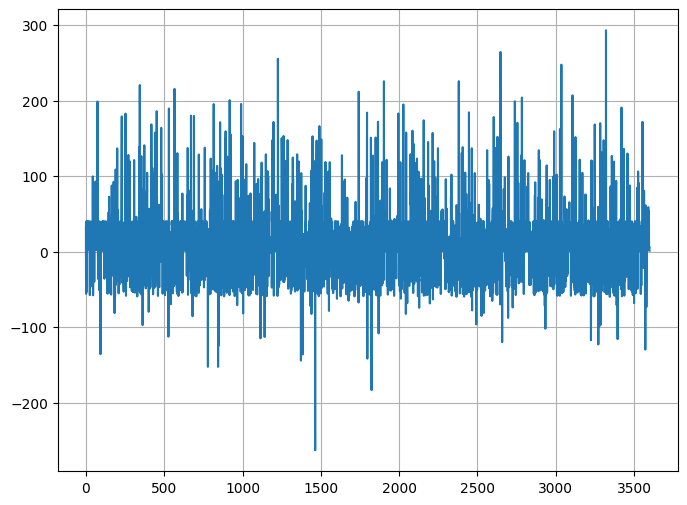

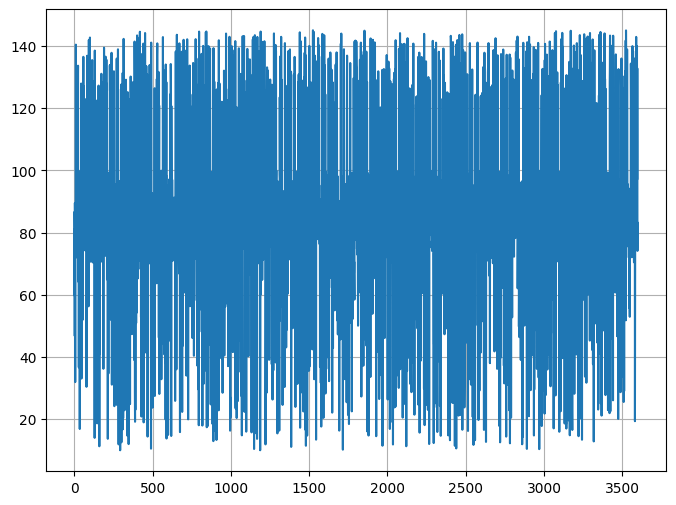

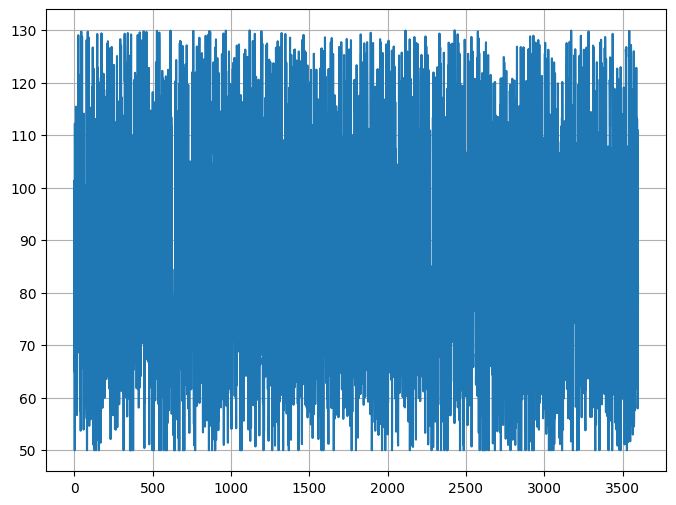

...

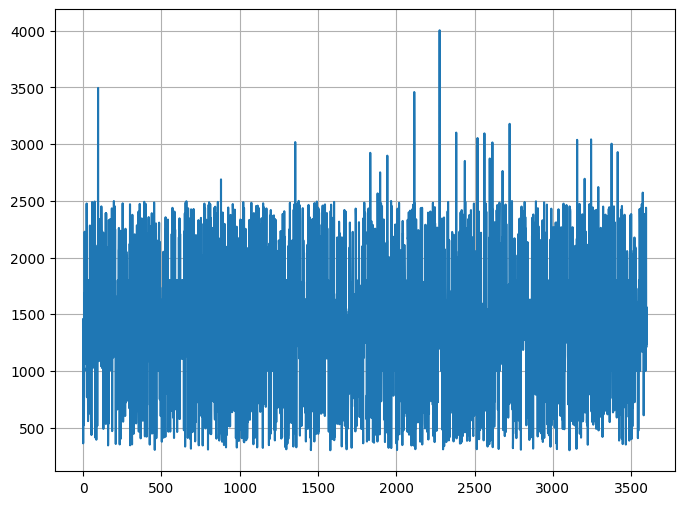

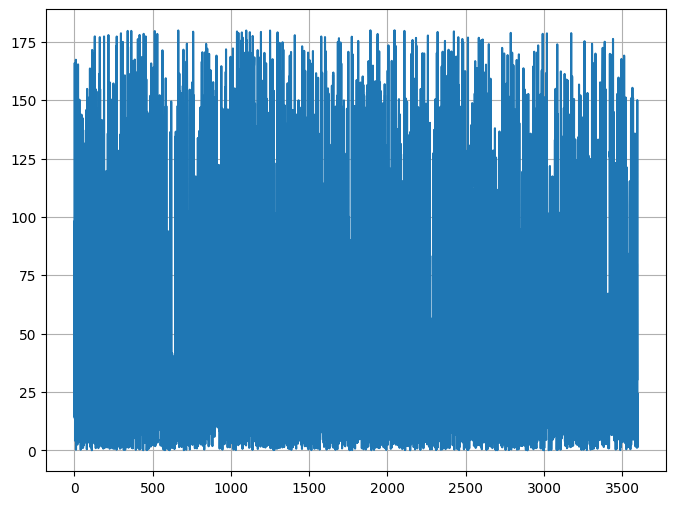

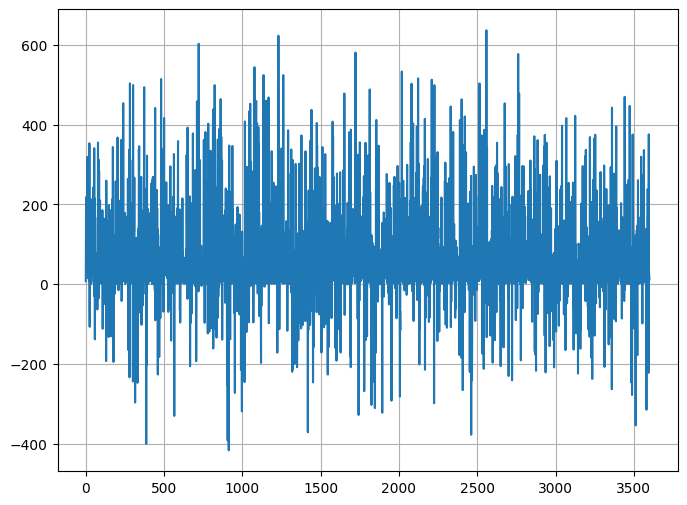

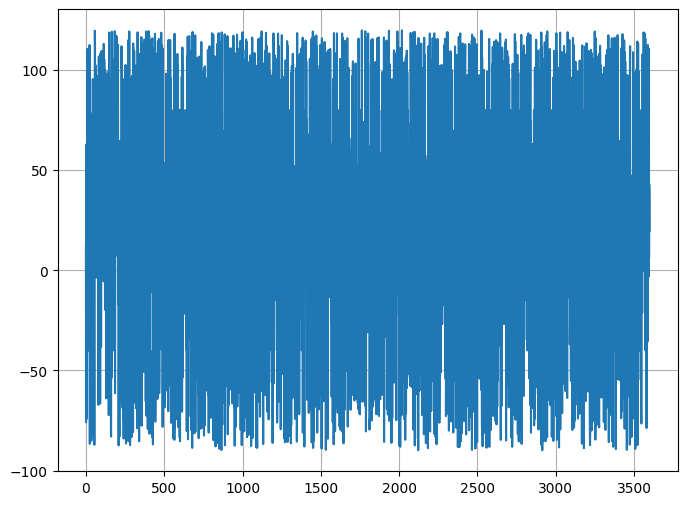

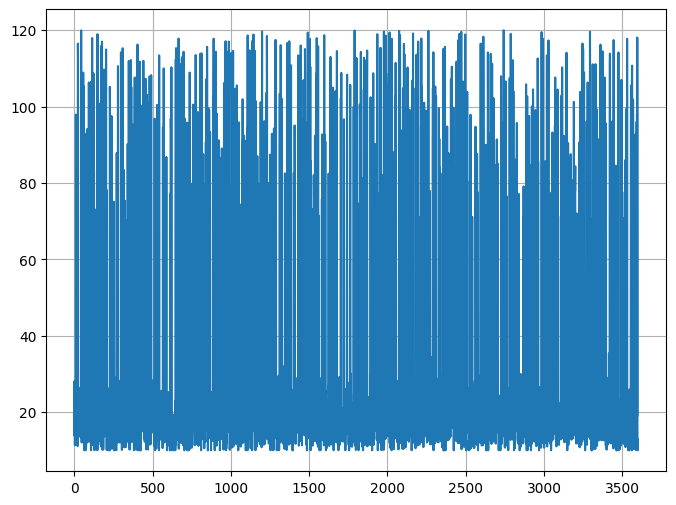

In [22]:
for column in df.select_dtypes(include="number").columns:
    plt.figure(figsize=(8,6))
    plt.plot(df.index, df[column])
    plt.grid(True)
    plt.show()

## Lag Plot

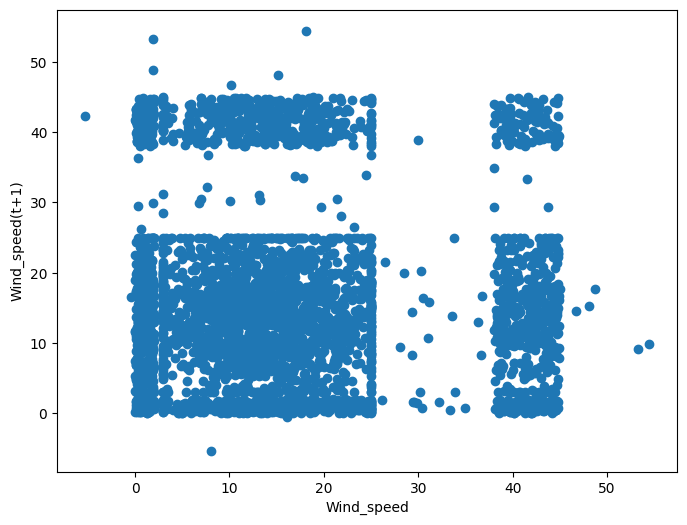

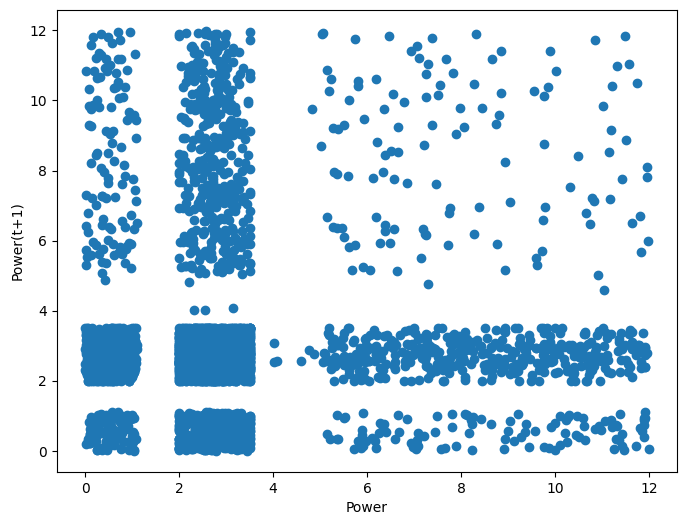

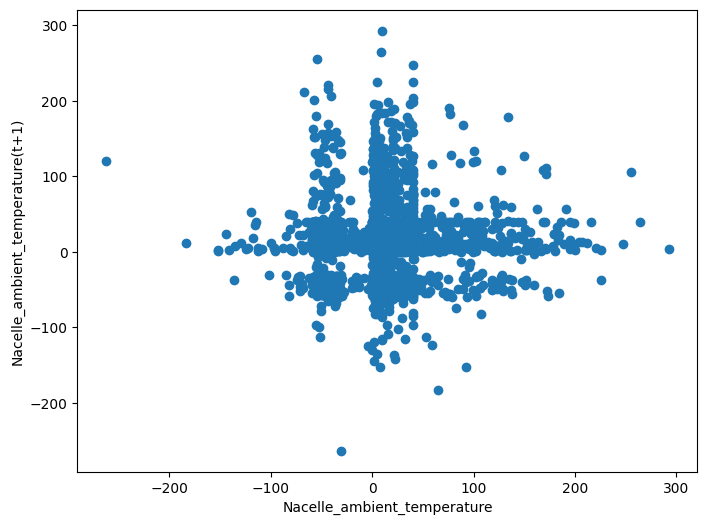

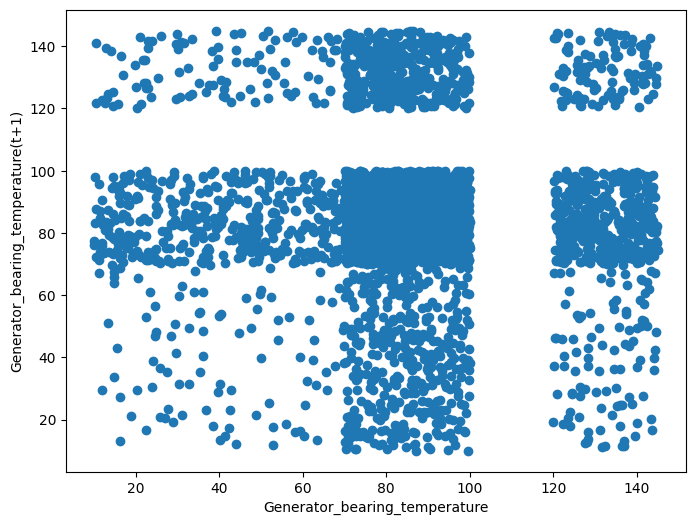

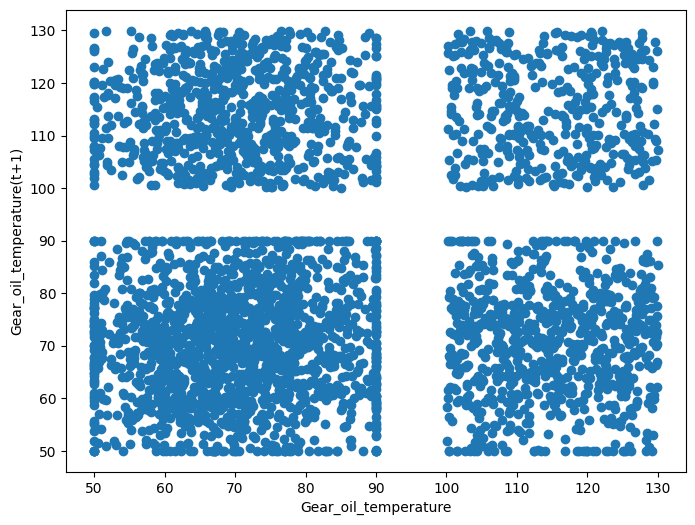

...

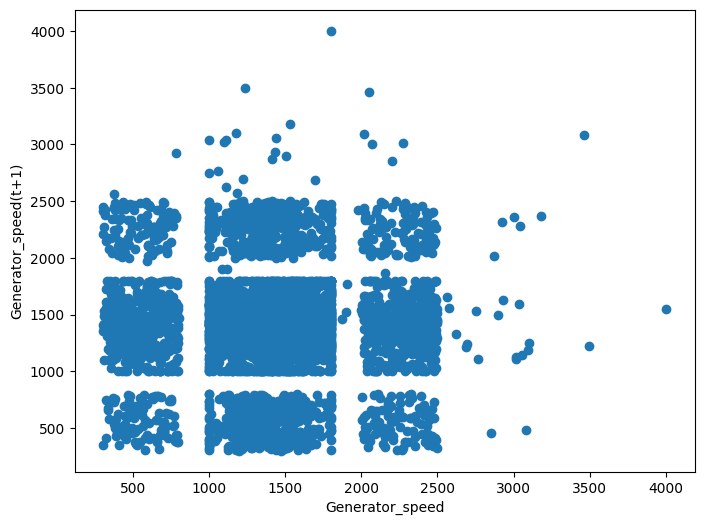

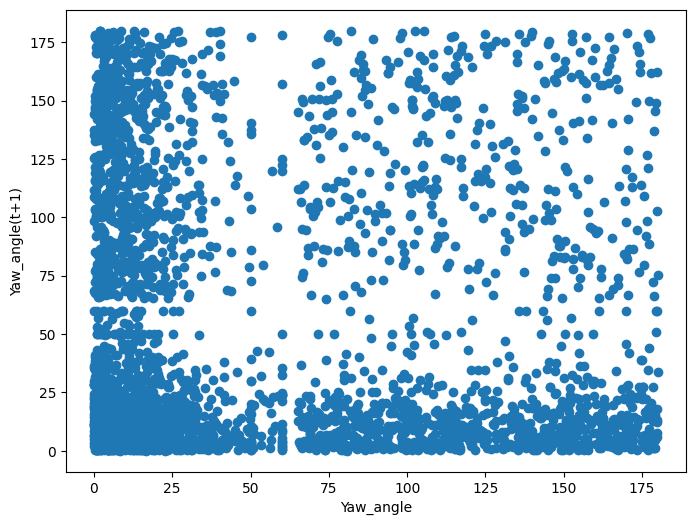

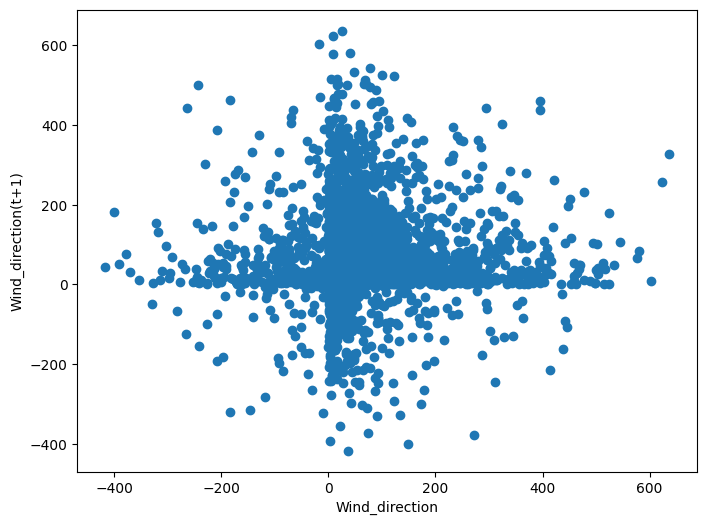

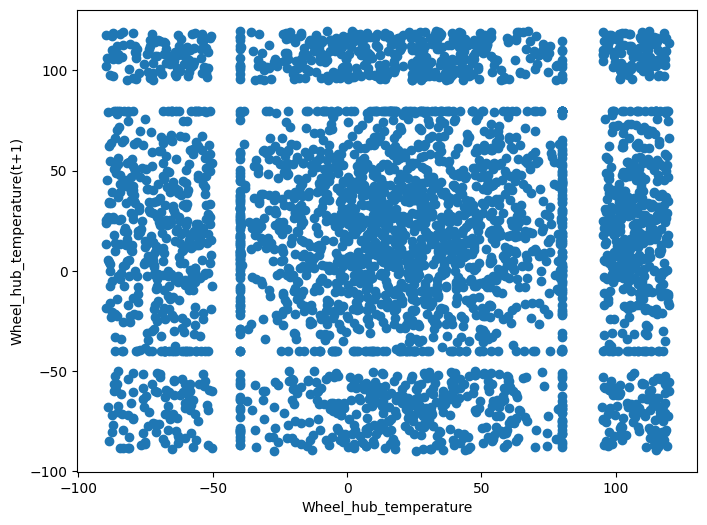

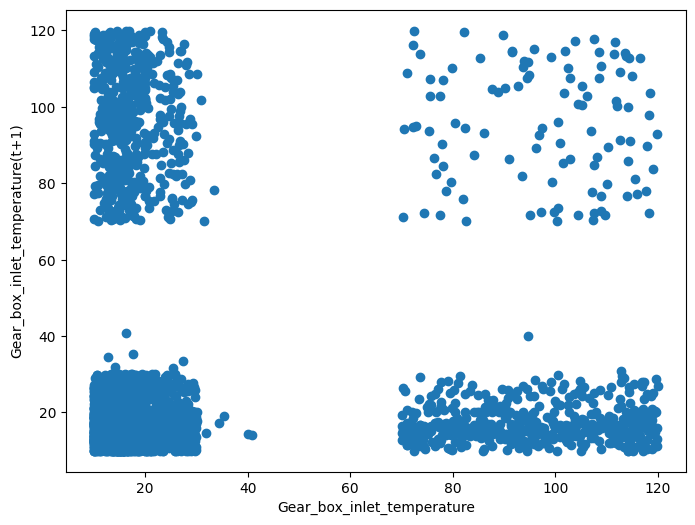

In [23]:
for column in df.select_dtypes(include="number").columns:
    plt.figure(figsize=(8,6))
    lag_plot(df[column], lag=1)
    plt.xlabel(f'{column}')
    plt.ylabel(f'{column}(t+{1})')
    plt.show()

# Bivariate Analysis

## Scatter plot

In [24]:
df.columns

Index(['date', 'Wind_speed', 'Power', 'Nacelle_ambient_temperature',
       'Generator_bearing_temperature', 'Gear_oil_temperature',
       'Ambient_temperature', 'Rotor_Speed', 'Nacelle_temperature',
       'Bearing_temperature', 'Generator_speed', 'Yaw_angle', 'Wind_direction',
       'Wheel_hub_temperature', 'Gear_box_inlet_temperature',
       'Failure_status'],
      dtype='object')

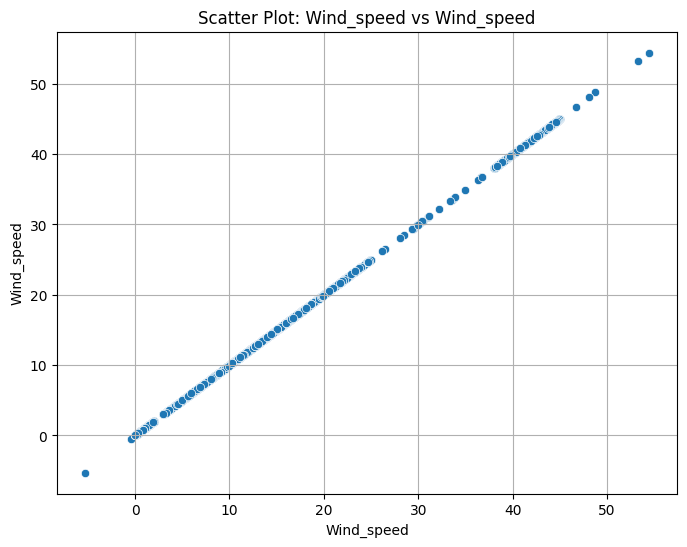

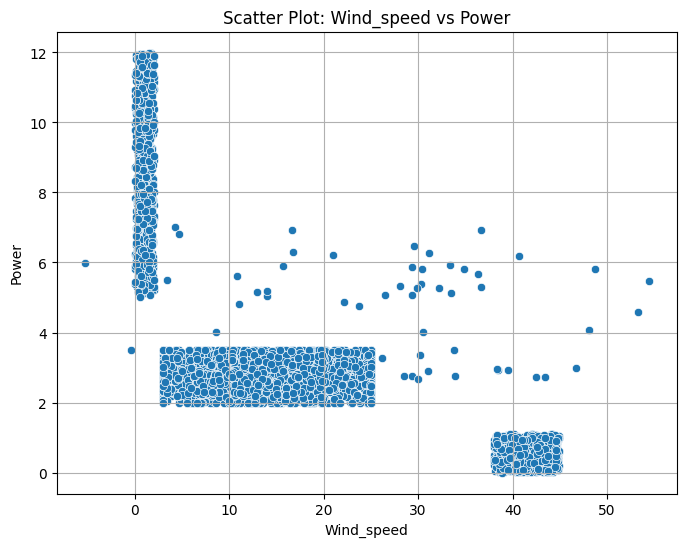

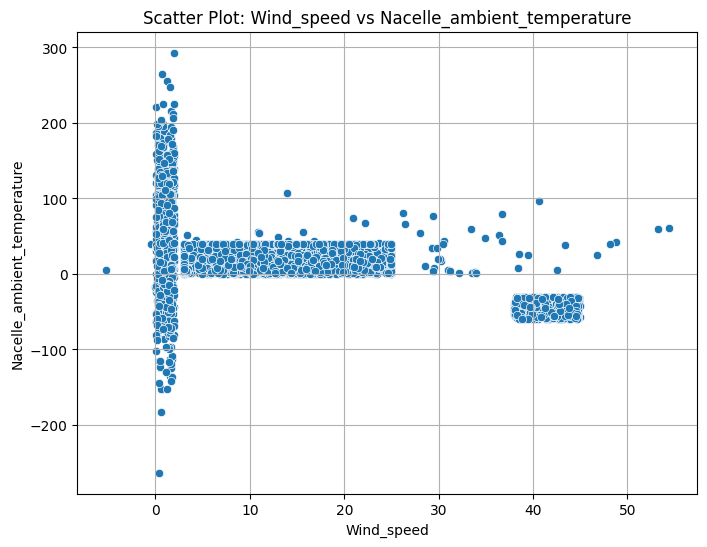

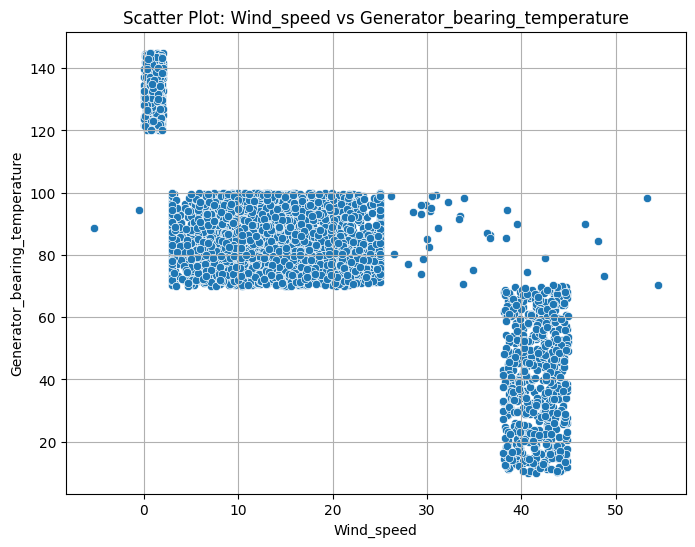

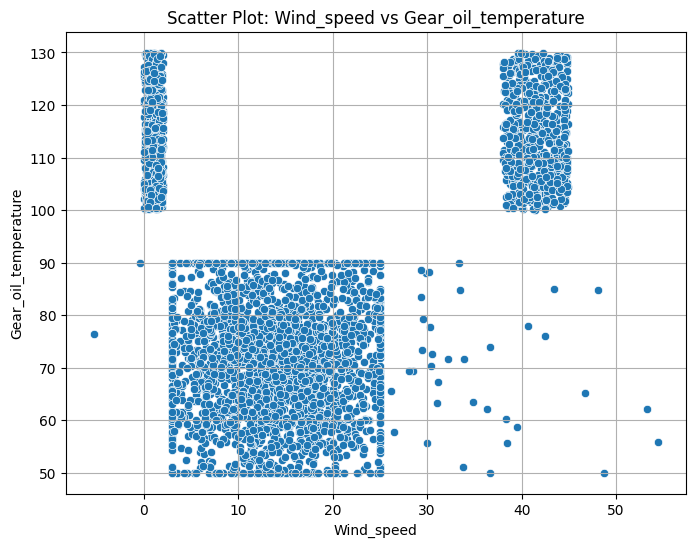

...

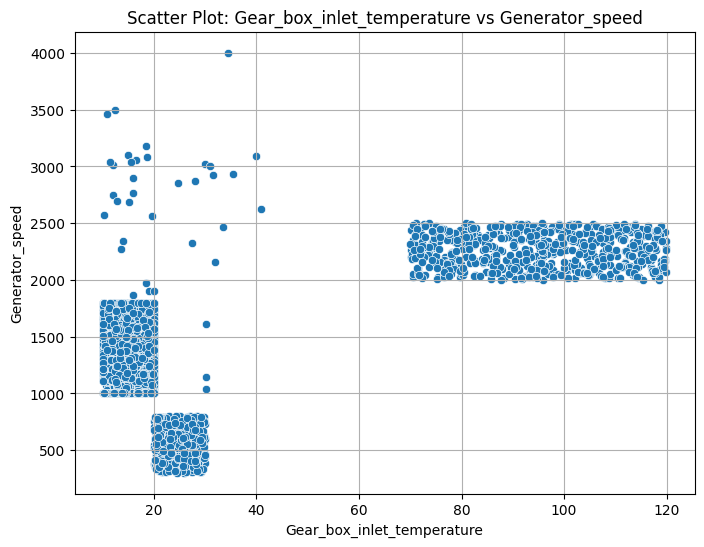

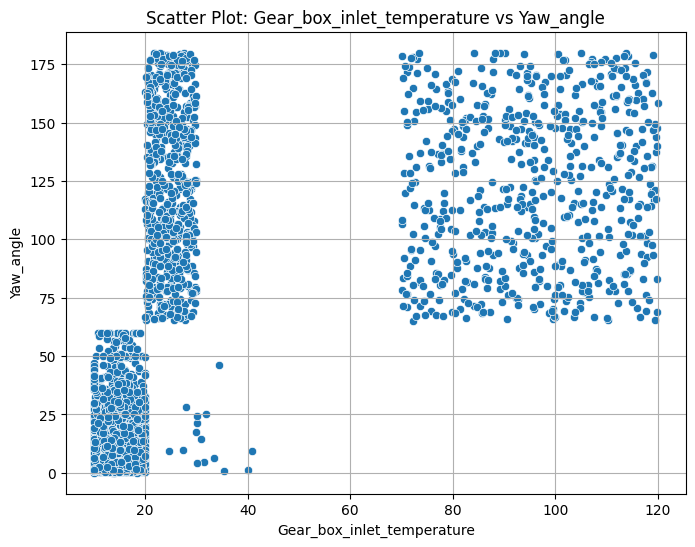

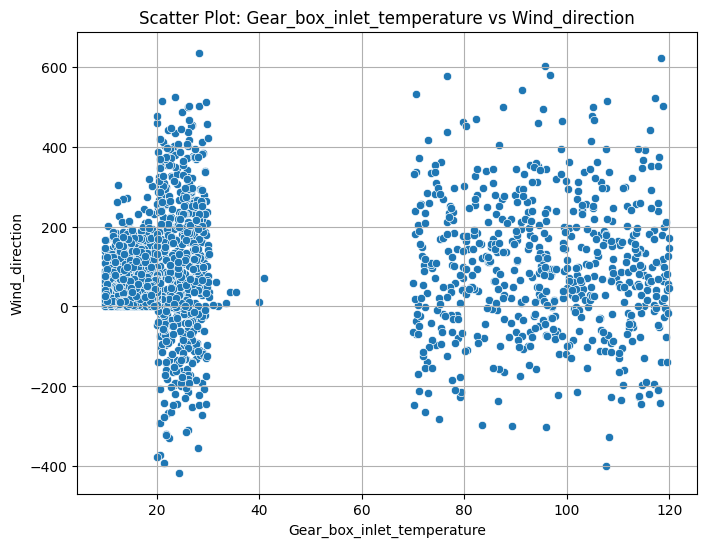

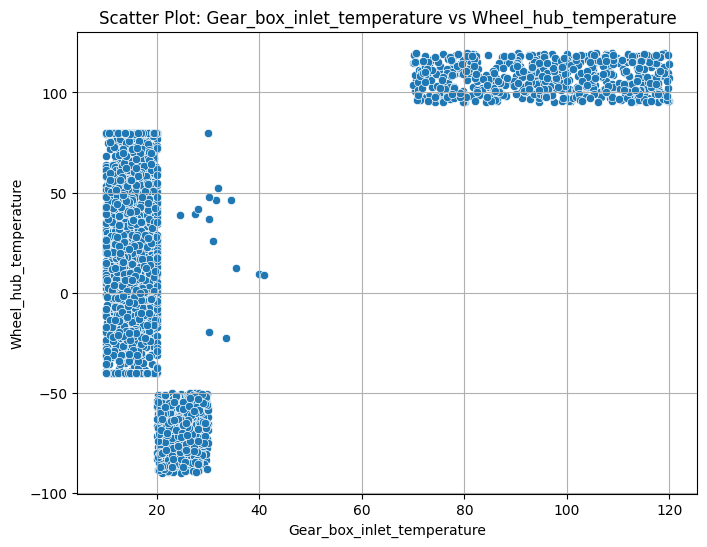

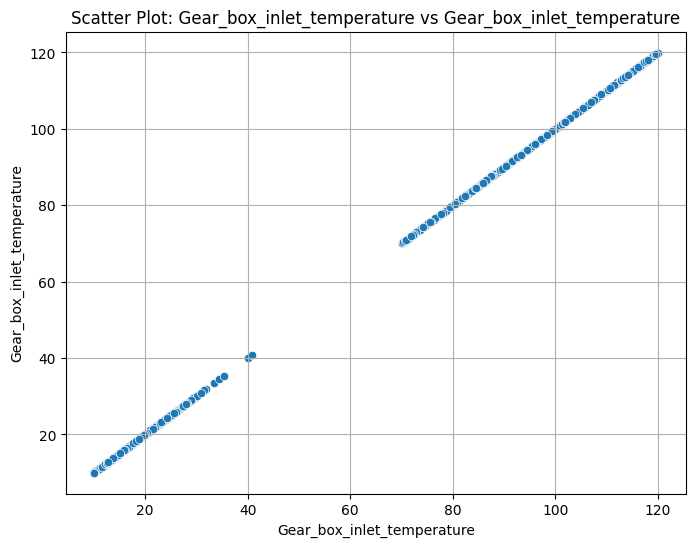

In [25]:
numerical_features = df.select_dtypes(include=['int64', 'float64']).columns

# Generate scatter plots for every pair of features
for i in range(len(numerical_features)):
    for j in range(len(numerical_features)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=df[numerical_features[i]], y=df[numerical_features[j]])
        plt.title(f'Scatter Plot: {numerical_features[i]} vs {numerical_features[j]}')
        plt.xlabel(numerical_features[i])
        plt.ylabel(numerical_features[j])
        plt.grid(True)
        plt.show()


In [26]:
df.select_dtypes(include="number").corr()

,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature
Wind_speed,1.000000,-0.688229,-0.567536,-0.813724,0.219612,-0.602848,-0.750535,-0.812030,-0.785020,-0.777425,0.232908,0.041393,-0.781082,-0.421246
Power,-0.688229,1.000000,0.470666,0.825690,0.289578,0.814819,0.816200,0.813488,0.797151,0.810880,0.279631,0.082980,0.776605,0.811758
Nacelle_ambient_temperature,-0.567536,0.470666,1.000000,0.559582,-0.163503,0.414984,0.511132,0.568497,0.531213,0.563981,-0.151314,-0.005013,0.535656,0.287759
Generator_bearing_temperature,-0.813724,0.825690,0.559582,1.000000,0.033725,0.752060,0.829485,0.856632,0.838473,0.838805,0.022192,0.012390,0.822198,0.649847
Gear_oil_temperature,0.219612,0.289578,-0.163503,0.033725,1.000000,0.335529,0.107499,-0.021366,0.028386,-0.006485,0.830028,0.205597,-0.016151,0.637085
Ambient_temperature,-0.602848,0.814819,0.414984,0.752060,0.335529,1.000000,0.752825,0.725601,0.726281,0.716358,0.332906,0.091364,0.702194,0.798768
Rotor_Speed,-0.750535,0.816200,0.511132,0.829485,0.107499,0.752825,1.000000,0.816513,0.798294,0.792095,0.102342,0.033111,0.777557,0.683488
Nacelle_temperature,-0.812030,0.813488,0.568497,0.856632,-0.021366,0.725601,0.816513,1.000000,0.833233,0.855379,-0.035258,0.000602,0.821075,0.608250
Bearing_temperature,-0.785020,0.797151,0.531213,0.838473,0.028386,0.726281,0.798294,0.833233,1.000000,0.810197,0.023649,0.022649,0.794206,0.630279
Generator_speed,-0.777425,0.810880,0.563981,0.838805,-0.006485,0.716358,0.792095,0.855379,0.810197,1.000000,-0.019566,0.005968,0.798997,0.604606


## Stationarity

In [27]:
from statsmodels.tsa.stattools import adfuller

for column in df.select_dtypes(include="number").columns:
    result = adfuller(df[column].dropna())
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])

ADF Statistic: -61.313153394432
p-value: 0.0
ADF Statistic: -59.72830446831045
p-value: 0.0
ADF Statistic: -60.624305431005915
p-value: 0.0
ADF Statistic: -60.4578336693424
p-value: 0.0
ADF Statistic: -40.08777067315266
p-value: 0.0
ADF Statistic: -59.43752642969282
p-value: 0.0
ADF Statistic: -58.609262975376836
p-value: 0.0
ADF Statistic: -60.28968557552761
p-value: 0.0
ADF Statistic: -59.520189003652526
p-value: 0.0
ADF Statistic: -59.752800239719406
p-value: 0.0
ADF Statistic: -40.74890133900976
p-value: 0.0
ADF Statistic: -59.06760616269065
p-value: 0.0
ADF Statistic: -59.930613850549285
p-value: 0.0
ADF Statistic: -58.62405469479334
p-value: 0.0


## Random Walk

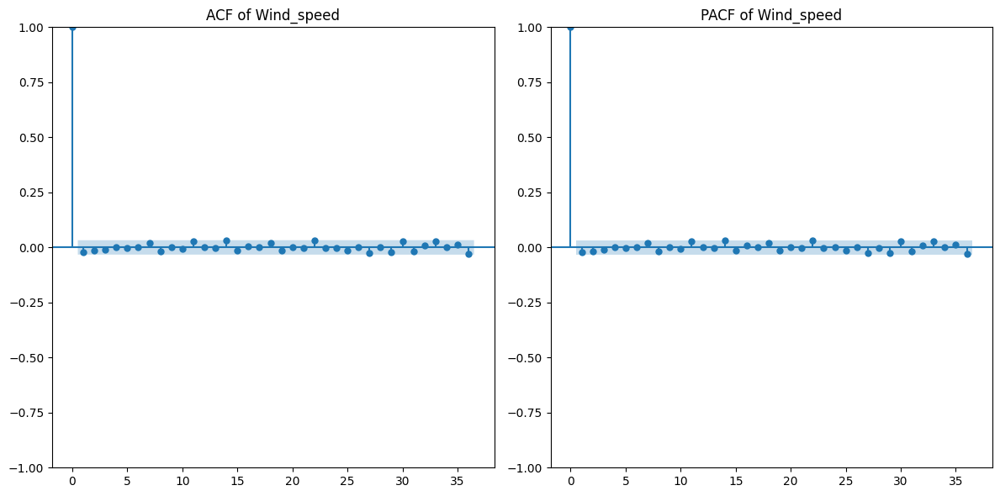

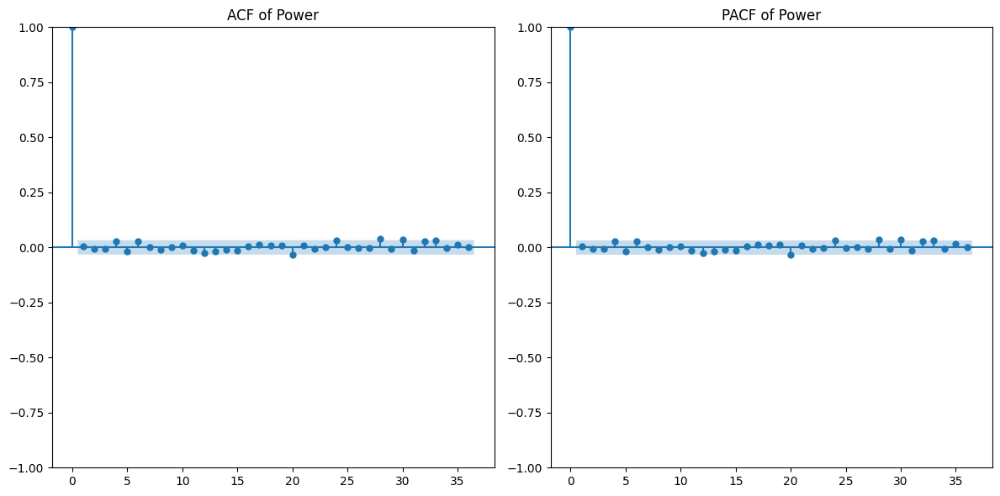

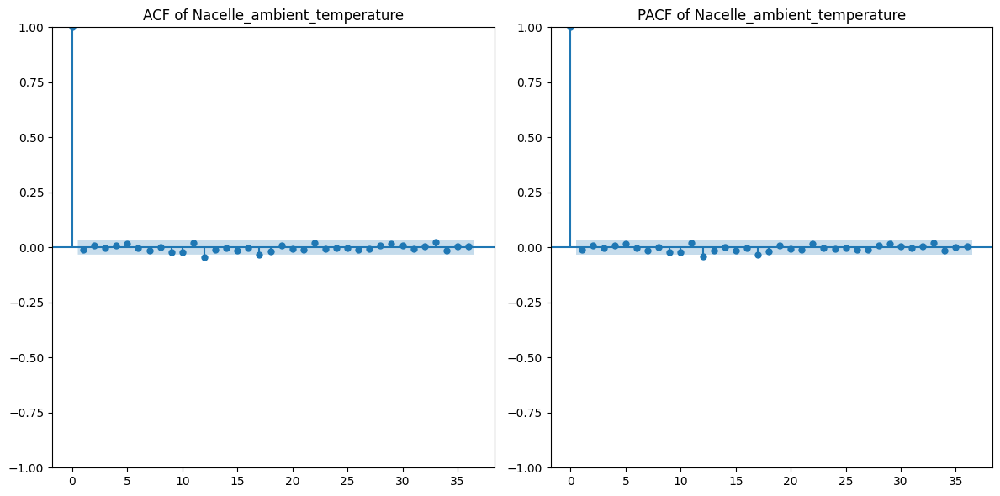

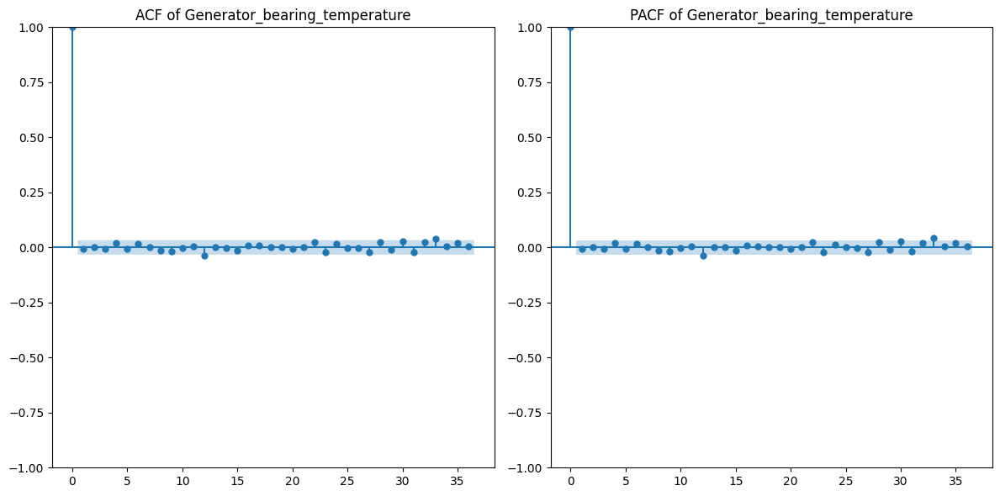

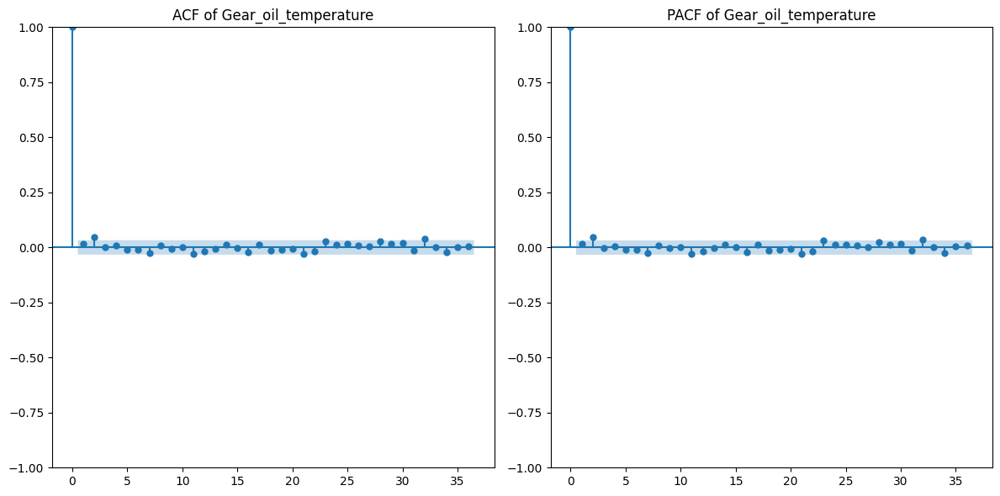

...

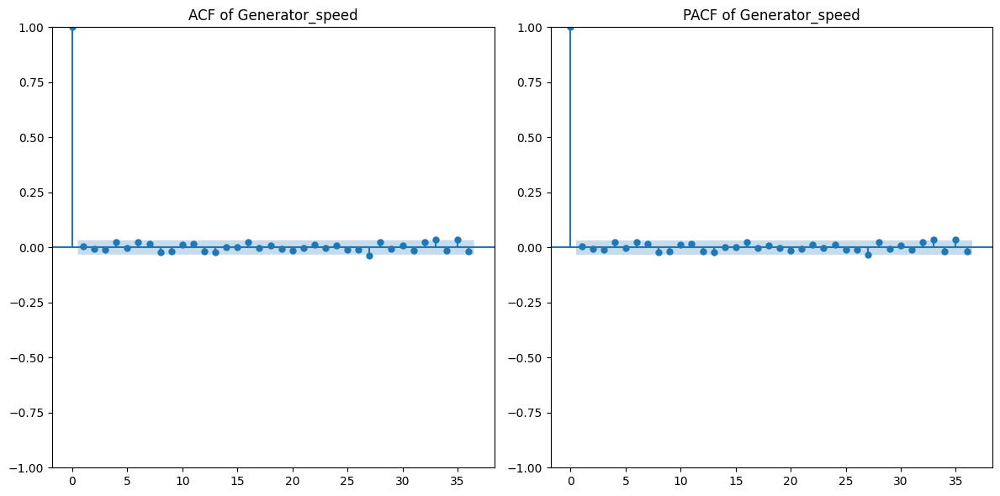

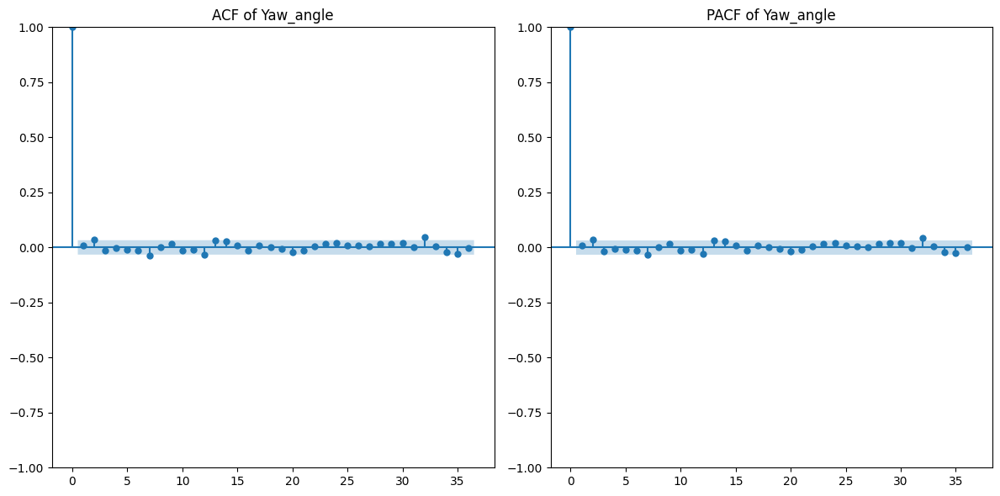

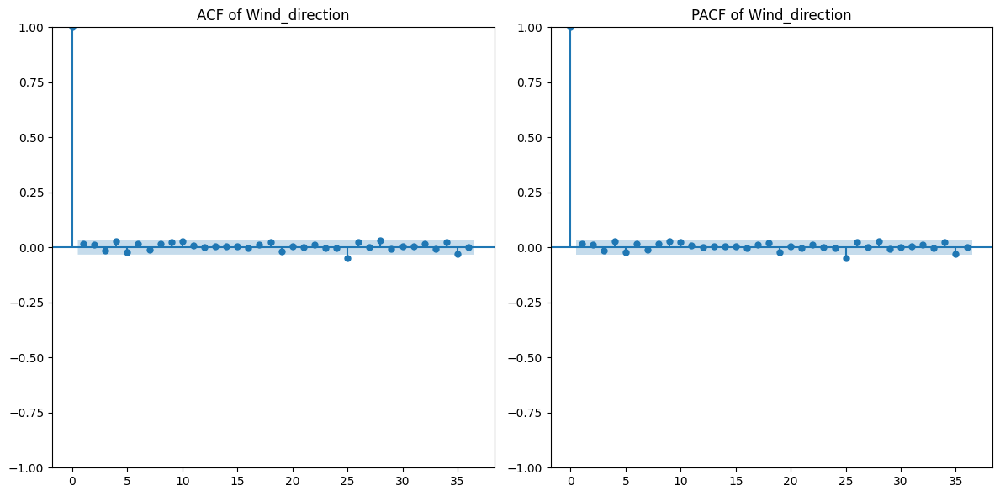

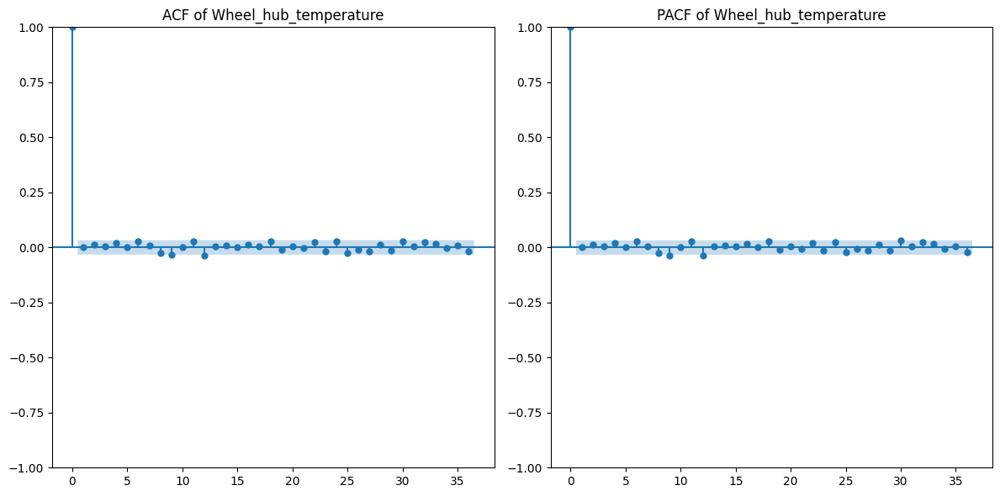

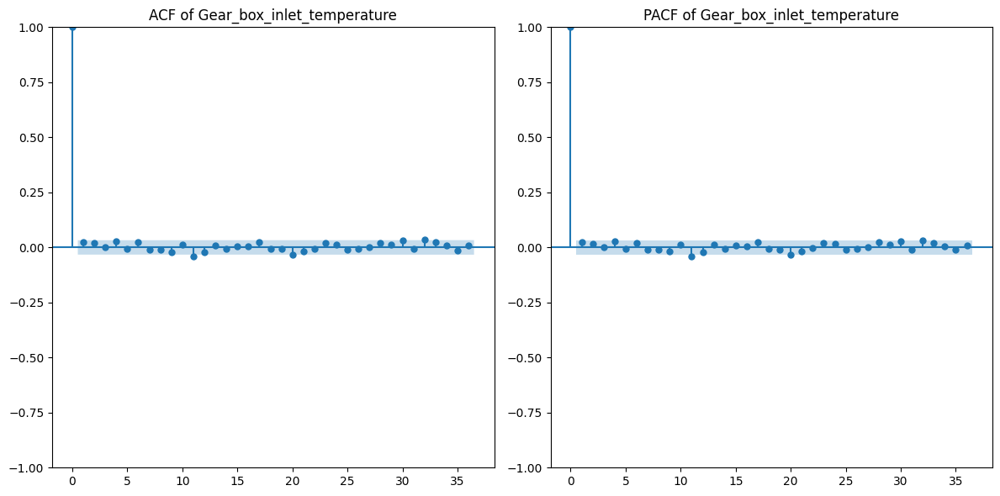

In [28]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

for column in df.select_dtypes(include="number").columns:
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plot_acf(df[column].dropna(), ax=plt.gca())
    plt.title(f'ACF of {column}')
    
    plt.subplot(1, 2, 2)
    plot_pacf(df[column].dropna(), ax=plt.gca())
    plt.title(f'PACF of {column}')
    
    plt.tight_layout()
    plt.show()

# Data Preprocessing

## Checking outliers using boxplot

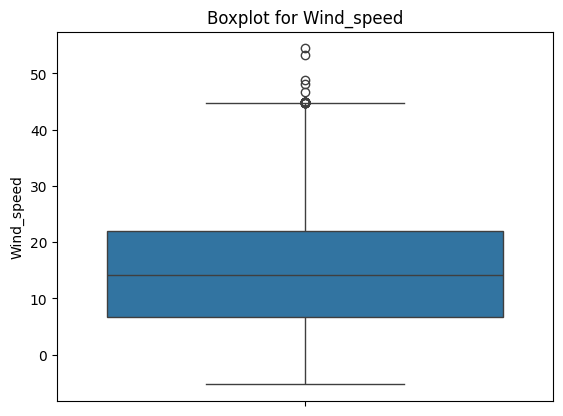

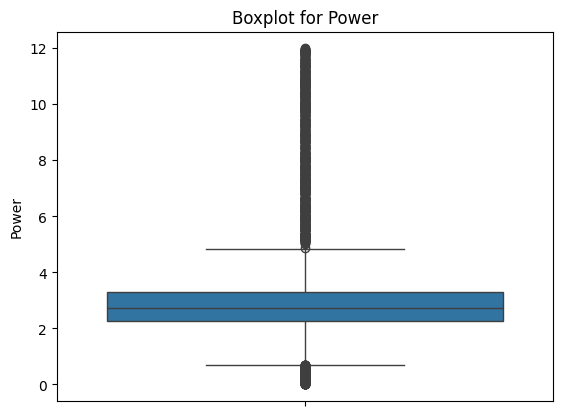

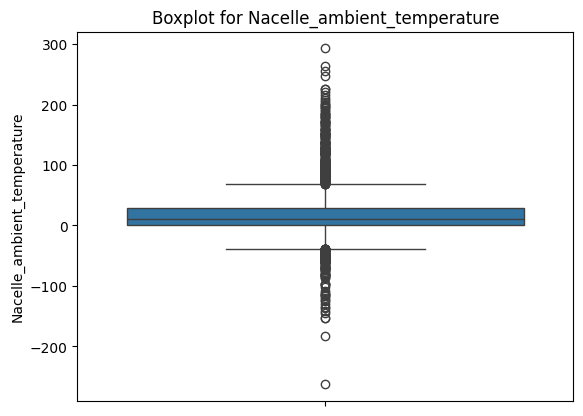

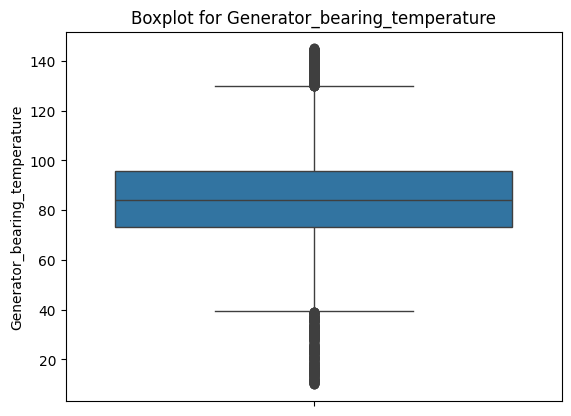

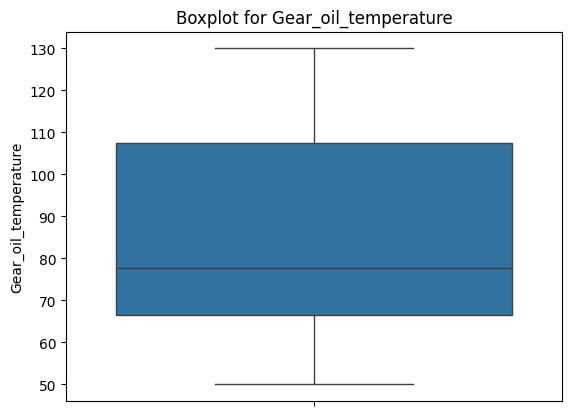

...

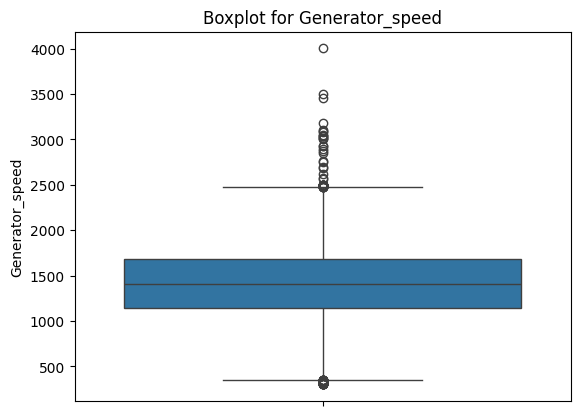

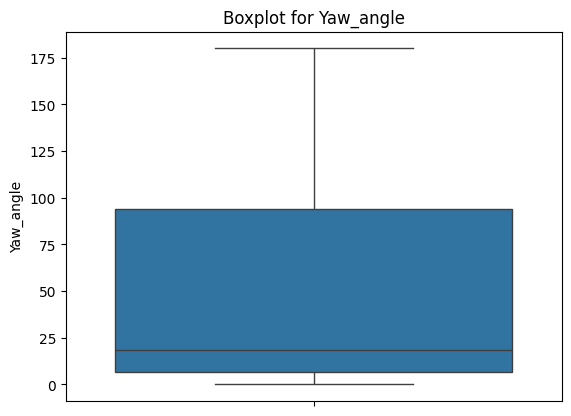

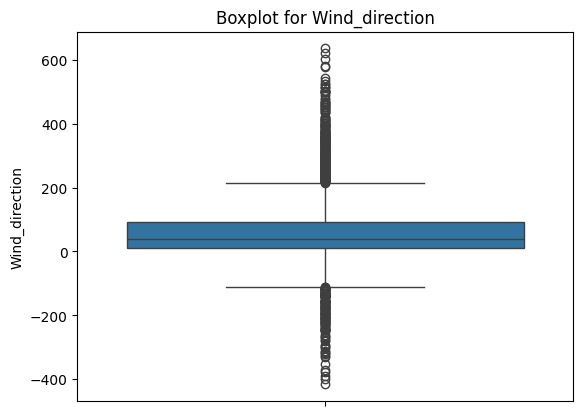

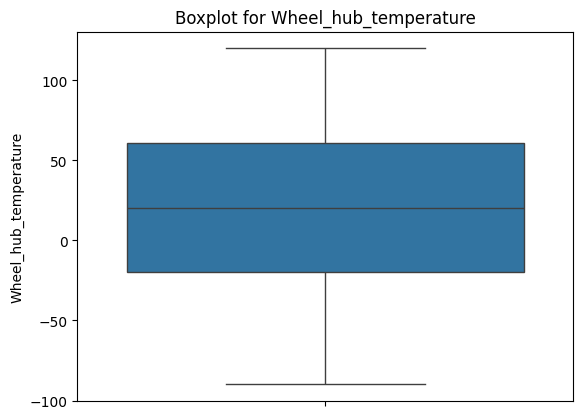

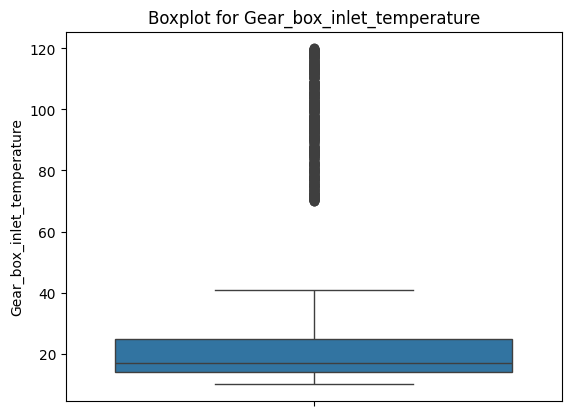

In [29]:
for column in df.select_dtypes(include="number").columns:
    sns.boxplot(data=df[column])
    plt.title(f'Boxplot for {column}')
    plt.show()

## Removing Outliers using IQR

In [30]:
for column in df.select_dtypes(include="number").columns:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3-Q1
    lower_bound = Q1-1.5*IQR
    upper_bound = Q3+1.5*IQR
    df[column] = np.where(
        df[column]>upper_bound,
        upper_bound,
        np.where(
            df[column]<lower_bound,
            lower_bound,
            df[column]
        )
    )

## Removing outliers using Z-Score

In [31]:
# for column in df.select_dtypes(include=np.number).columns:
#     upper_limit = df[column].mean() + 3*df[column].std()
#     lower_limit = df[column].mean() - 3*df[column].std()

#     df[column] = np.where(
#         df[column]>upper_limit, 
#         upper_limit,
#         np.where(
#             df[column]<lower_limit,
#             lower_limit,
#             df[column]
#         )
#     )

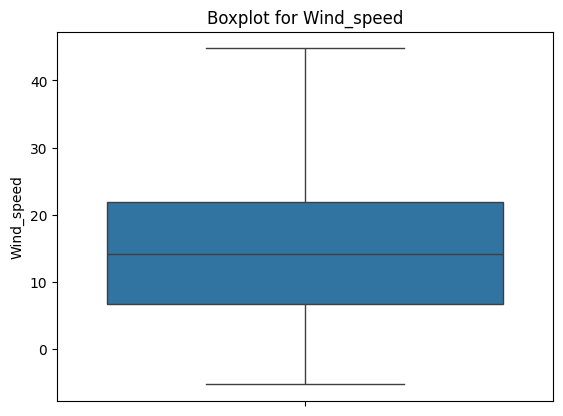

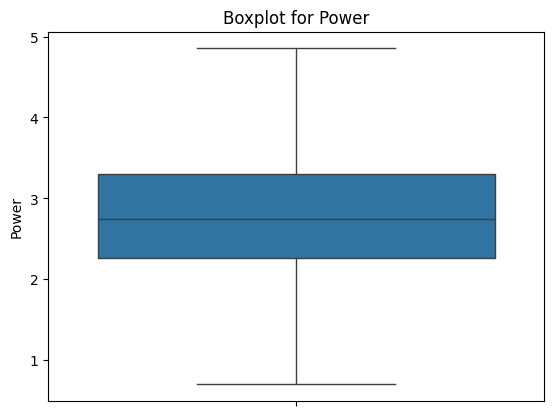

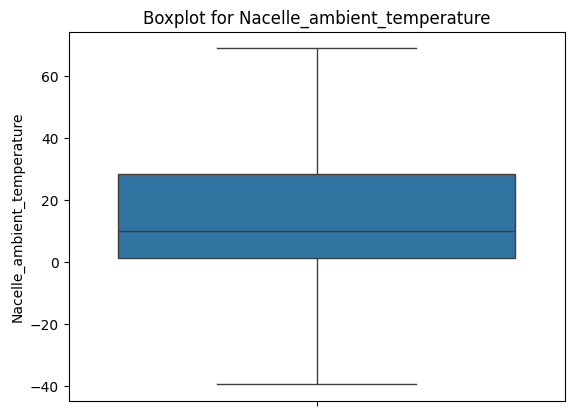

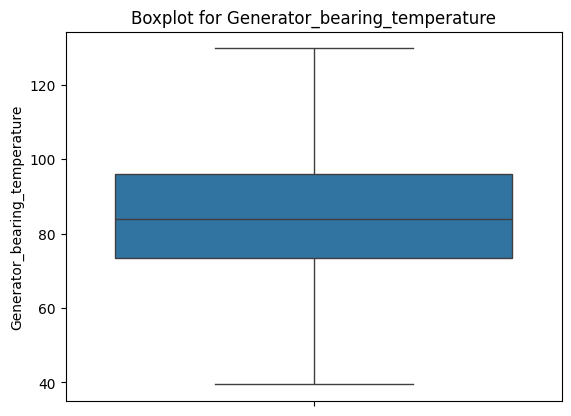

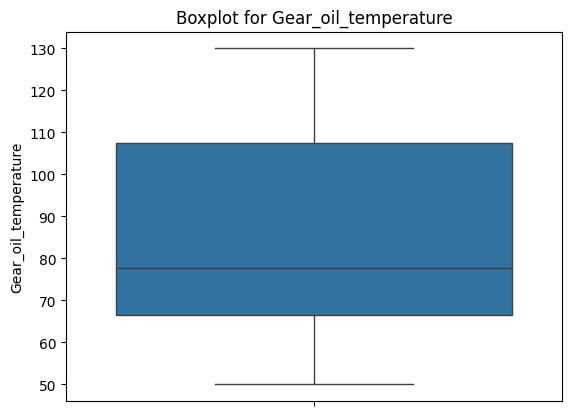

...

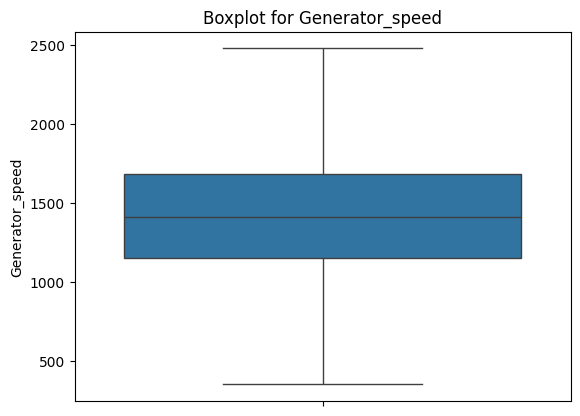

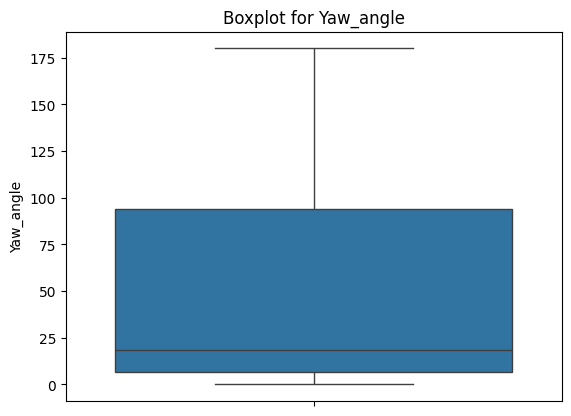

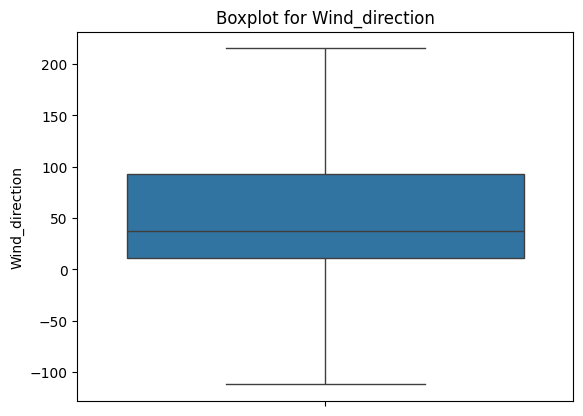

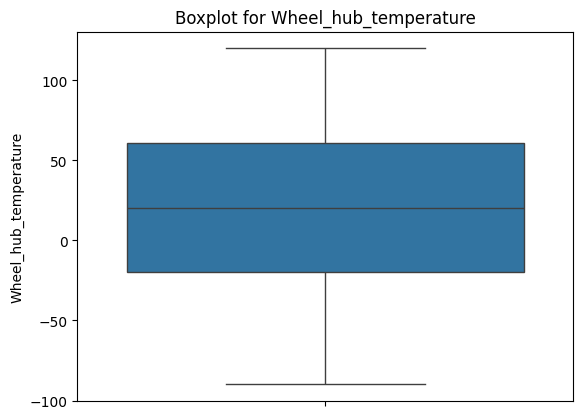

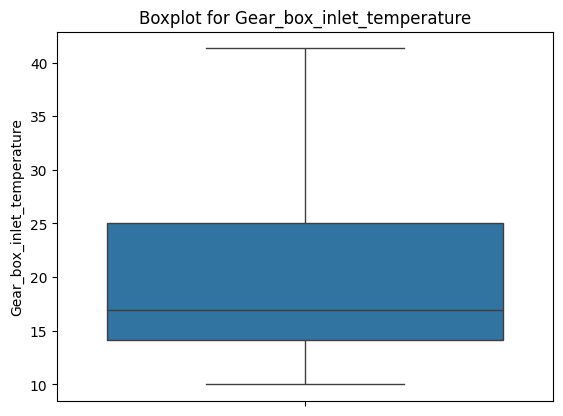

In [32]:
for column in df.select_dtypes(include="number").columns:
    sns.boxplot(data=df[column])
    plt.title(f'Boxplot for {column}')
    plt.show()

# Feature Scaling/Extraction

In [33]:
df['date'] = pd.to_datetime(df['date'])

In [34]:
df['month'] = df['date'].dt.month

In [35]:
df

,date,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature,Failure_status,month
0,2021-02-01,7.878531,2.315370,32.740165,86.452399,65.049688,33.680184,134.147513,56.460579,100.000000,1456.017383,14.437189,7.276999,12.738843,17.584294,No_failure,2
1,2021-04-29,43.880415,0.780599,-39.419563,59.779321,101.430997,-17.601422,24.198260,4.494620,39.030739,361.979447,98.159201,148.106847,-75.941163,28.078778,Failure,4
2,2021-07-27,14.215257,2.089855,40.000000,81.044978,50.000000,28.690093,134.453792,43.267269,93.971237,1402.969527,14.889174,209.730805,62.908711,13.796216,No_failure,7
3,2021-06-05,41.578706,0.697791,-39.419563,46.767316,112.224552,-2.777622,23.758713,7.769757,25.000000,520.033943,165.953430,215.249807,-74.258910,21.982525,Failure,6
4,2021-05-26,19.067139,2.973043,12.731400,89.489402,84.527008,40.000000,111.173738,48.206219,70.000000,1167.887109,13.514680,32.583664,7.287559,11.303292,No_failure,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,2021-09-29,0.031313,4.855252,53.310500,129.794034,111.028171,79.748352,358.913420,86.518857,145.000000,2439.353445,150.049320,215.249807,110.750778,41.325515,Failure,9
3596,2021-03-10,3.231213,2.598571,4.208532,74.090434,57.955346,22.602701,52.221794,47.037018,70.000000,1292.399953,9.812319,35.541569,6.268785,15.082957,No_failure,3
3597,2021-11-02,3.005981,3.020017,6.834426,83.197439,61.598519,38.776535,121.583425,31.492799,80.490588,1210.191300,1.306543,25.583091,42.951647,10.000000,No_failure,11
3598,2021-06-11,19.858333,2.608177,2.710879,77.173335,74.066225,6.828494,214.499735,45.924037,100.000000,1563.565899,2.552398,12.700684,38.294409,12.619178,No_failure,6


## Extracting seasons out of month

In [36]:
bins = [0, 3, 6, 9, 12]  # Define the bin edges (exclusive of the right edge)
labels = ['Winter', 'Spring', 'Summer', 'Autumn'] # Labels for the bins

df['Season'] = pd.cut(df['month'], bins=bins, labels=labels, right=False) # right=False means the intervals are closed on the left


In [37]:
df

,date,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature,Failure_status,month,Season
0,2021-02-01,7.878531,2.315370,32.740165,86.452399,65.049688,33.680184,134.147513,56.460579,100.000000,1456.017383,14.437189,7.276999,12.738843,17.584294,No_failure,2,Winter
1,2021-04-29,43.880415,0.780599,-39.419563,59.779321,101.430997,-17.601422,24.198260,4.494620,39.030739,361.979447,98.159201,148.106847,-75.941163,28.078778,Failure,4,Spring
2,2021-07-27,14.215257,2.089855,40.000000,81.044978,50.000000,28.690093,134.453792,43.267269,93.971237,1402.969527,14.889174,209.730805,62.908711,13.796216,No_failure,7,Summer
3,2021-06-05,41.578706,0.697791,-39.419563,46.767316,112.224552,-2.777622,23.758713,7.769757,25.000000,520.033943,165.953430,215.249807,-74.258910,21.982525,Failure,6,Summer
4,2021-05-26,19.067139,2.973043,12.731400,89.489402,84.527008,40.000000,111.173738,48.206219,70.000000,1167.887109,13.514680,32.583664,7.287559,11.303292,No_failure,5,Spring
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,2021-09-29,0.031313,4.855252,53.310500,129.794034,111.028171,79.748352,358.913420,86.518857,145.000000,2439.353445,150.049320,215.249807,110.750778,41.325515,Failure,9,Autumn
3596,2021-03-10,3.231213,2.598571,4.208532,74.090434,57.955346,22.602701,52.221794,47.037018,70.000000,1292.399953,9.812319,35.541569,6.268785,15.082957,No_failure,3,Spring
3597,2021-11-02,3.005981,3.020017,6.834426,83.197439,61.598519,38.776535,121.583425,31.492799,80.490588,1210.191300,1.306543,25.583091,42.951647,10.000000,No_failure,11,Autumn
3598,2021-06-11,19.858333,2.608177,2.710879,77.173335,74.066225,6.828494,214.499735,45.924037,100.000000,1563.565899,2.552398,12.700684,38.294409,12.619178,No_failure,6,Summer


## Normalization/Standardization

In [38]:
scaler = StandardScaler()

numerical_cols = df.select_dtypes(include="number").columns

df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

In [39]:
df

,date,Wind_speed,Power,Nacelle_ambient_temperature,Generator_bearing_temperature,Gear_oil_temperature,Ambient_temperature,Rotor_Speed,Nacelle_temperature,Bearing_temperature,Generator_speed,Yaw_angle,Wind_direction,Wheel_hub_temperature,Gear_box_inlet_temperature,Failure_status,month,Season
0,2021-02-01,-0.660946,-0.378863,0.757445,0.044030,-0.863149,0.572873,-0.435915,0.480723,0.613859,0.080499,-0.633033,-0.619716,-0.127666,-0.346965,No_failure,-1.310621,Winter
1,2021-04-29,2.054395,-1.614406,-1.650585,-1.035503,0.702695,-1.205647,-1.330468,-1.828941,-1.434111,-1.958520,0.857660,1.186263,-1.662607,0.693589,Failure,-0.730665,Spring
2,2021-07-27,-0.183016,-0.560410,0.999712,-0.174823,-1.510885,0.399810,-0.433423,-0.105663,0.411352,-0.018369,-0.624986,1.976519,0.740712,-0.722563,No_failure,0.139270,Summer
3,2021-06-05,1.880795,-1.681069,-1.650585,-1.562134,1.167248,-0.691536,-1.334044,-1.683375,-1.905407,-1.663946,2.064755,2.047294,-1.633490,0.089130,Failure,-0.150708,Summer
4,2021-05-26,0.182923,0.150586,0.089736,0.166945,-0.024849,0.792053,-0.622831,0.113852,-0.393847,-0.456506,-0.649459,-0.295188,-0.222021,-0.969743,No_failure,-0.440686,Spring
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,2021-09-29,-1.252800,1.665827,1.443894,1.798184,1.115756,2.170583,1.392792,1.816684,2.125418,1.913197,1.781578,2.047294,1.568799,2.007036,Failure,0.719227,Autumn
3596,2021-03-10,-1.011457,-0.150877,-0.194679,-0.456293,-1.168488,0.188690,-1.102467,0.061886,-0.393847,-0.224444,-0.715381,-0.257256,-0.239655,-0.594979,No_failure,-1.020643,Spring
3597,2021-11-02,-1.028444,0.188401,-0.107051,-0.087707,-1.011687,0.749622,-0.538137,-0.628988,-0.041466,-0.377661,-0.866828,-0.384962,0.395280,-1.098967,No_failure,1.299183,Autumn
3598,2021-06-11,0.242597,-0.143144,-0.244657,-0.331519,-0.475079,-0.358382,0.217835,0.012419,0.613859,0.280943,-0.844645,-0.550164,0.314669,-0.839269,No_failure,-0.150708,Summer


In [40]:
import sys

print(sys.executable)

C:\Python312\python.exe
